In [2]:
%load_ext autoreload
%autoreload 2
%config InlineBackend.figure_format = 'retina'

In [3]:
import scanpy as sc
import pandas as pd
import scanpy as sc 
import sys 
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd
import warnings
from matplotlib.colors import LinearSegmentedColormap
import matplotlib.pyplot as plt
import matplotlib as mpl

warnings.filterwarnings('ignore')
sys.path.append('../../src')

from spaceoracle.plotting.cartography import Cartography
import celloracle as co
from celloracle.applications import Gradient_calculator
from celloracle.applications.scatter_to_grid import scatter_value_to_grid_value
from celloracle.applications.differentiation_flow import get_gradient, normalize_gradient
from spaceoracle.virtual_tissue import VirtualTissue

%matplotlib inline

In [177]:
adata = sc.read_h5ad('/Volumes/SSD/training_data/snrna_human_tonsil.h5ad')
adata.obsm['X_umap'] = pd.read_csv('../../notebooks/human_tonsil/umap.csv', index_col=0).values
adata.obs = adata.obs.join(pd.read_csv('../../notebooks/human_tonsil/tonsil_cell_types.csv', index_col=0))

sc.pp.pca(adata)
sc.pp.neighbors(adata)


In [5]:
adata.layers['imputed_count'] = np.load('../../notebooks/human_tonsil/imputed_counts.npy')

In [178]:
import json

with open('./colors.json', 'r') as f:
    color_dict = json.load(f)

In [179]:
adata.obs['cell_type_major'] = adata.obs.cell_type_2.replace(
    {
        'GC Dark Zone': 'Germinal Center B cells', 
        'GC Light Zone': 'Germinal Center B cells', 
        'GC Intermediate Zone': 'Germinal Center B cells', 
        'plasma': 'Plasma cells', 
        'B_naive': 'B cells', 
        'B_memory': 'B cells', 
        'B_germinal_center': 'Germinal Center B cells', 
        'Naive CD4 T': 'T cells', 
        'Treg': 'T cells', 
        'T memory': 'T cells', 
        'Th1': 'T cells', 
        'Th2': 'T cells', 
        'T_CD8': 'T cells', 
        'T_follicular_helper': 'T cells', 
        'mDC': 'Dendritic cells', 
        'FDC': 'Dendritic cells', 
        'myeloid': 'Myeloid cells', 
        'NK': 'NK cells', 
        'pDC': 'Dendritic cells', 
        'T_double_neg': 'T cells'
    }
)

In [181]:
%matplotlib inline

figure_params = {
    'dpi': 300, 
    'bbox_inches': 'tight', 
    'format': 'svg', 
    'transparent': True
}

plt.rcParams.update({
    "text.usetex": False,
    "svg.fonttype": 'none'
})

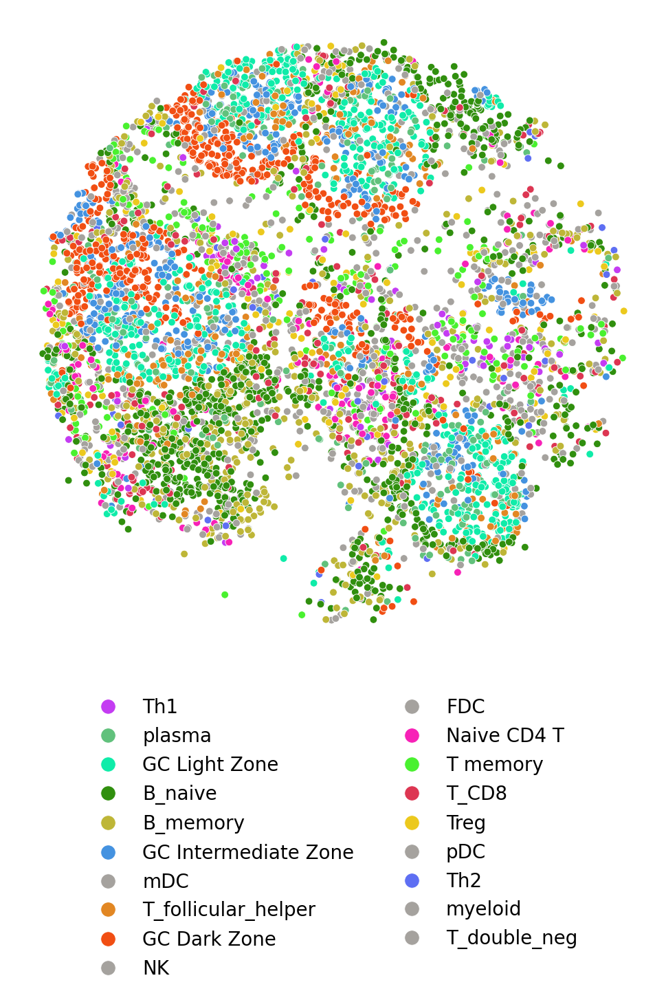

In [97]:
plt.rcParams['figure.figsize'] = (6, 6)

import alphashape

ct_points_wt = {}
for ct in adata.obs['cell_type_2'].unique():
    points = np.asarray(
        adata[adata.obs['cell_type_2'] == ct].obsm['spatial'])
    delta = 30
    points = np.vstack(
        (points +[-delta,delta], points +[-delta,-delta], 
        points +[delta,delta], points +[delta,-delta]))
    ct_points_wt[ct] = points

# adatax = adata[~adata.obs.cell_type_major.isin([
#     'Myeloid cells', 'Dendritic cells', 'NK cells'])]

adatax = adata

sns.scatterplot(data=adatax.obs, 
    x=adatax.obsm['spatial'][:,0], 
    y=adatax.obsm['spatial'][:,1],
    s=15,
    hue='cell_type_2',
    legend='brief', palette=color_dict)
plt.axis('off')


plt.legend(bbox_to_anchor=(0.5, -0.05), 
    loc='upper center', ncol=2, frameon=False, 
    markerscale=2, fontsize=10)

plt.show()

In [159]:
tonsil = VirtualTissue(
    adata = adata,
    annot = 'cell_type_2',
    # betadatas_path = '/ix/djishnu/shared/djishnu_kor11/lasso_runs/human_tonsil',
    # ko_path = '/ix/djishnu/shared/djishnu_kor11/genome_screens/human_tonsil',
    betadatas_path = '/Volumes/SSD/lasso_runs/human_tonsil',
    ko_path = '/Volumes/SSD/genome_screens/human_tonsil',
    color_dict=color_dict
)

rename={
    'T_follicular_helper': 'T Follicular\nHelper',
    'T_CD8': 'CD8+ T',
    'T_CD4': 'non-Tfh\nCD4+ T',
    'B_germinal_center': 'B Germinal\nCenter',
    'B_naive': 'B\nNaive',
    'B_memory': 'B\nMemory',
}

In [160]:
# co_grn.links

In [165]:
extra = tonsil.compute_ko_impact(
    annot='cell_type', 
    baseline_only=False,
    genes=['CUX2', 'IL24', 'HIC2', 'IL23R', 'IL21']
)

In [166]:
impact_df = pd.read_csv('../../notebooks/human_tonsil/impact_df.csv', index_col=0)

In [163]:
from spaceoracle.tools.network import RegulatoryFactory
co_grn = RegulatoryFactory(
    colinks_path='/Volumes/SSD/training_data/snrna_human_tonsil_colinks.pkl',
    annot='cell_type_int'
)

In [168]:
genes = [
    'PAX5', 'BCL6',  'GATA3', 'STAT4', 'FOXO1', 'FOXP3', 
    'IL7', 'IL4',  'IL6ST', 'GZMA', 'IL10', 'LGALS9', 
    'PDCD1', 'CD27',  'CXCR4', 'CCR2', 'IL7R', 'CD19' 
]

genesets = [
    ['PAX5', 'BCL6',  'STAT4', 'FOXO1'],
    ['IL4',  'IL6ST', 'GZMA', 'IL21'],
    ['PDCD1', 'CCR2', 'IL7R', 'CD19'],
    # ['PAX5', 'CUX2', 'FOSL2', 'HIC2']
]

show_for = [
    'B_germinal_center', 'B_naive', 'T_CD4',  
    'B_memory', 'T_follicular_helper', 'T_CD8'
]

fig, axs = plt.subplots(1, 4, figsize=(35, 8), dpi=300,
                subplot_kw={'projection': 'polar'})

tonsil.plot_radar(impact_df=impact_df.join(extra),
    genes=genesets,
    show_for=show_for, 
    figsize=(30, 8),
    dpi=300,
    label_size=18,
    legend_size=20,
    rename=rename,
    axes=axs,
    fig=fig,
    colors=
        [
            [
                "#F8766D",
                "#7CAE00",
                "#00BFC4",
                "#C77CFF"
            ], 
            
            [
                "#0ab4f1",
                "#8fcd51",
                "#7e46b8",
                "#f50707",
            ],
            [
                "#8d96c3",
                "#c4513a",
                "#79b796",
                "#4c3c3c"
            ]
         ]
)

tonsil.plot_radar(impact_df=impact_df.join(extra),
    genes=['IL23R', 'CUX2', 'IL24', 'HIC2'],
    show_for=show_for, 
    figsize=(30, 8),
    dpi=300,
    label_size=18,
    normalize=False,
    legend_size=20,
    rename=rename,
    fig=fig,
    axes=axs[-1],
)

fontsize = 30
axs[0].set_title('Transcription\nFactors\n\n', fontsize=fontsize)
axs[1].set_title('Ligands\n\n', fontsize=fontsize)
axs[2].set_title('Receptors\n\n', fontsize=fontsize)
axs[3].set_title('Control Genes\n\n', fontsize=fontsize)


plt.savefig('./figures/spider_plots_B.svg', **figure_params)
plt.show()

In [171]:
from spaceoracle.models.parallel_estimators import create_spatial_features
from scipy.stats import pearsonr
from spaceoracle.plotting.cartography import xy_from_adata

RADIUS = 200

xy = xy_from_adata(adata)

spf = create_spatial_features(
    x=adata.obsm['spatial'][:, 0], 
    y=adata.obsm['spatial'][:, 1], 
    celltypes=adata.obs.cell_type_2, 
    obs_index=adata.obs_names,
    radius = RADIUS
)

In [203]:
adata.obs['cell_type_major'] = adata.obs.cell_type_2.replace(
    {
        'GC Dark Zone': 'Germinal Center B cells', 
        'GC Light Zone': 'Germinal Center B cells', 
        'GC Intermediate Zone': 'Germinal Center B cells', 
        'plasma': 'Plasma cells', 
        'B_naive': 'B cells', 
        'B_memory': 'B cells', 
        'B_germinal_center': 'Germinal Center B cells', 
        'Naive CD4 T': 'T cells', 
        'Treg': 'T cells', 
        'T memory': 'T cells', 
        'Th1': 'T cells', 
        'Th2': 'T cells', 
        'T_CD8': 'T cells', 
        'T_follicular_helper': 'T cells', 
        'mDC': 'Dendritic cells', 
        'FDC': 'Dendritic cells', 
        'myeloid': 'Myeloid cells', 
        'NK': 'NK cells', 
        'pDC': 'Dendritic cells', 
        'T_double_neg': 'T cells'
    }
)

In [204]:
cell_groups = {
    'GC B Cells': ['GC Light Zone', 'GC Dark Zone', 'GC Intermediate Zone'],
    'B cells': ['GC Light Zone', 'GC Dark Zone', 'GC Intermediate Zone', 'B_naive', 'B_memory'],
    'T cells': ['Naive CD4 T', 'T_follicular_helper', 'Th2', 'Th1', 'Treg'],
    'T cells': ['Naive CD4 T', 'T_follicular_helper', 'Th2', 'Th1', 'Treg'],
    'All T cells': ['Naive CD4 T', 'T_follicular_helper', 'Th2', 'Th1', 'Treg', 'T_CD8'],
    
}

In [205]:
def plot_gene_vs_proximity(perturb_target, perturbed_df, gene, color_gene, cell_filter, 
                          proximity_threshold=150, gene_threshold=0.005, ax=None, mode='ko'):
    # perturbed_df = pd.read_parquet(
    #     f'/Volumes/SSD/genome_screens/human_tonsil/{perturb_target}_4n_maxx.parquet')
    
    datadf = spf[
        [i+'_within' for i in cell_groups['GC B Cells']
            ]].sum(1).to_frame().join(adata.obs.cell_type_2).query(
             f'cell_type_2.isin(["{cell_filter}"])').join(xy).join(
        ((perturbed_df-adata.to_df(layer='imputed_count'))/adata.to_df(layer='imputed_count'))*100
    )
    datadf = datadf[datadf[0] < proximity_threshold]
    
    if ax is None:
        ax = plt.gca()
    
    try:
        corr = pearsonr(datadf[datadf[gene]>gene_threshold][0], datadf[datadf[gene]>gene_threshold][gene]).statistic
        ax.set_title(f"{perturb_target} {mode} in\n{cell_filter}\nCorrelation: {corr:.4f}")
    except:
        corr = 0
        ax.set_title(f"{perturb_target} {mode} in\n{cell_filter}\nCorrelation: NaN")
        
    scatter = ax.scatter(
        datadf[0], 
        datadf[gene], 
        c=datadf[color_gene],
        cmap='rainbow',
    )
    cbar = plt.colorbar(scatter, label=f'{color_gene} % change', shrink=0.75, ax=ax, format='%.2f')
    cbar.ax.tick_params(labelsize=14)
    cbar.set_label(f'{color_gene} % change', fontsize=16)
    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)
    ax.set_ylabel(f'{gene} % change', fontsize=14)    
    ax.set_xlabel(f'Number of GC B cells within {RADIUS}um', fontsize=14)
    
    return ax, datadf

In [206]:
genes = [
    'PAX5', 'BCL6',  'GATA3', 'STAT4', 'FOXO1', 'FOXP3', 
    'IL7', 'IL4',  'IL6ST', 'GZMA', 'IL10', 'LGALS9', 
    'PDCD1', 'CD27',  'CXCR4', 'CCR2', 'IL7R', 'CD19'
]

genesets = [
    ['PAX5', 'BCL6',  'STAT4', 'FOXO1'],
    ['IL4',  'IL6ST', 'GZMA', 'IL10'],
    ['PDCD1', 'CCR2', 'IL7R', 'CD19']
]

show_for = [
    'B_germinal_center', 'B_naive', 'T_CD4',  
    'B_memory', 'T_follicular_helper', 'T_CD8'
]

In [207]:
label_dict ={
    'cell_type_2': [
        'B_naive', 'B_memory', 'T_follicular_helper', 'plasma',
        'Naive CD4 T', 'Th2', 'Th1', 'T_CD8', 'Treg'
        'GC Intermediate Zone', 'GC Light Zone', 'GC Dark Zone'],
    'cell_type_major': []
}

In [208]:
adata.obs['cell_type_paper'] = adata.obs['cell_type_major'].copy()

In [209]:
adata.obs['cell_type_paper'].value_counts()

cell_type_paper
Germinal Center B cells    1760
B cells                    1610
T cells                    1364
Dendritic cells             489
Plasma cells                283
NK cells                    170
Myeloid cells               102
Name: count, dtype: int64

In [210]:
adata.obs['cell_type_paper'] = adata.obs['cell_type_paper'].astype(str)
cell_types_to_rename = ['B_naive', 'B_memory', 'T_CD8', 'T_follicular_helper', 'Naive CD4 T', 'Th1', 'Th2', 'Treg']
mask = adata.obs.cell_type_2.isin(cell_types_to_rename)
adata.obs.loc[mask, 'cell_type_paper'] = adata.obs.loc[mask, 'cell_type_2']

In [211]:
adata.obs['cell_type_paper'] = adata.obs['cell_type_paper'].replace(
    {
        'Th1': 'non-Tfh CD4+ T', 
        'Th2': 'non-Tfh CD4+ T', 
        'Treg': 'non-Tfh CD4+ T',
        'Naive CD4 T': 'non-Tfh CD4+ T'
     
    })

In [212]:
color_dict['non-Tfh CD4+ T'] = "#c43cf2"

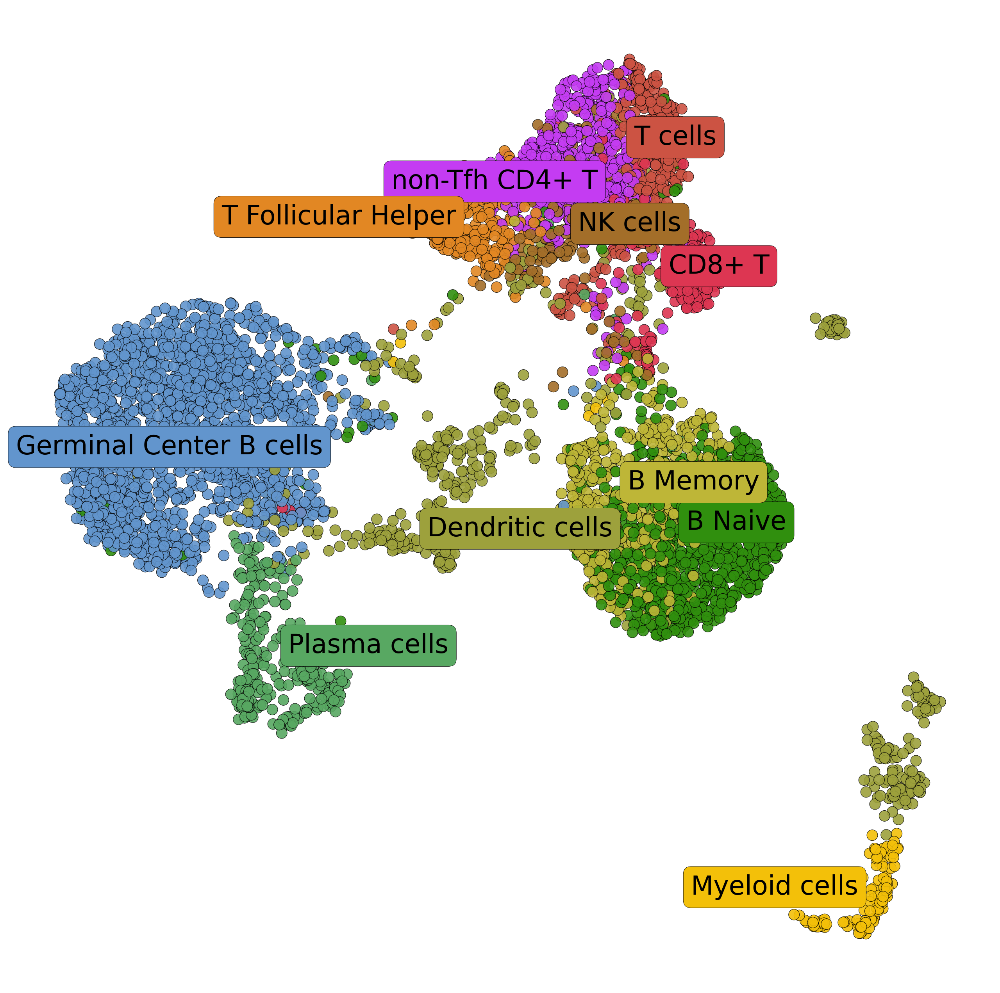

In [86]:
tonsil.init_cartography(adata)

tonsil.chart.plot_umap(
    hue='cell_type_paper',
    color_dict=color_dict,
    scatter_size=25,
    linewidth=0.2,
    legend_fontsize=12,
    figsize=(8, 8),
    rename={
        'T_follicular_helper': 'T Follicular Helper',
        'T_CD8': 'CD8+ T',
        'B_germinal_center': 'B Germinal Center',
        'B_naive': 'B Naive',
        'B_memory': 'B Memory',
    },
    dpi=200
)

plt.show()

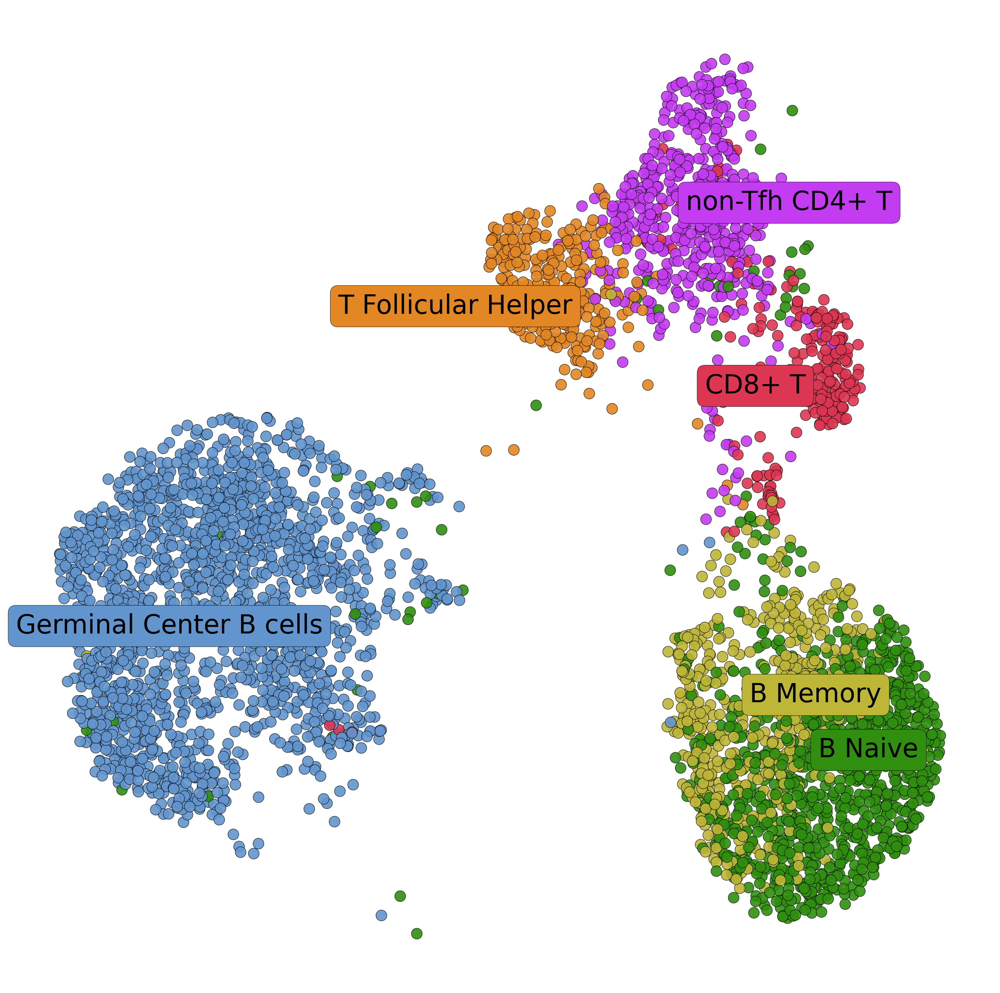

In [68]:
tonsil.init_cartography(adata[adata.obs.cell_type_paper.isin([
    'Germinal Center B cells', 
    # 'Plasma cells', 
    'B_naive', 'B_memory', 'T_CD8', 
    'T_follicular_helper', 'Naive CD4 T', 'non-Tfh CD4+ T'])])

tonsil.chart.plot_umap(
    hue='cell_type_paper',
    color_dict=color_dict,
    scatter_size=25,
    linewidth=0.2,
    legend_fontsize=12,
    figsize=(8, 8),
    rename={
        'T_follicular_helper': 'T Follicular Helper',
        'T_CD8': 'CD8+ T',
        'B_germinal_center': 'B Germinal Center',
        'B_naive': 'B Naive',
        'B_memory': 'B Memory',
    },
    dpi=200
)

plt.savefig('./figures/umap.svg', **figure_params)
plt.show()

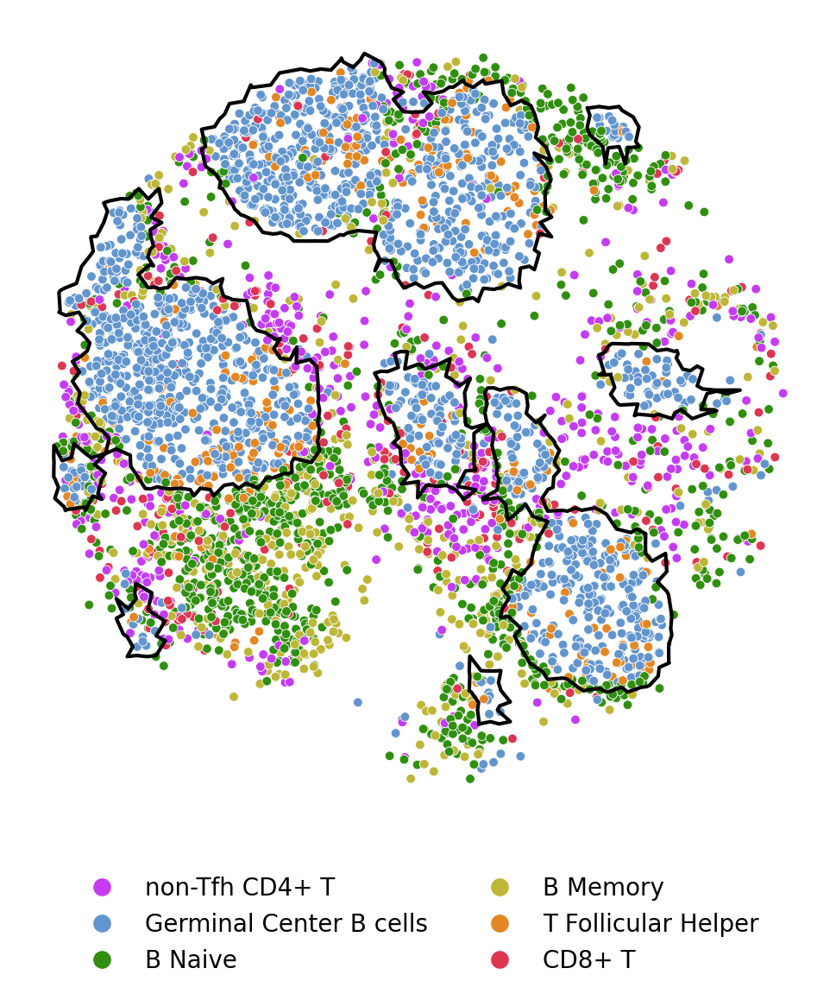

In [71]:
plt.rcParams['figure.figsize'] = (6, 6)

import alphashape

ct_points_wt = {}
for ct in adata.obs['cell_type_paper'].unique():
    points = np.asarray(
        adata[adata.obs['cell_type_paper'] == ct].obsm['spatial'])
    delta = 30
    points = np.vstack(
        (points +[-delta,delta], points +[-delta,-delta], 
        points +[delta,delta], points +[delta,-delta]))
    ct_points_wt[ct] = points

adatax = adata[adata.obs.cell_type_paper.isin([
    'Germinal Center B cells', 
    # 'Plasma cells', 
    'B_naive', 'B_memory', 'T_CD8', 
    'T_follicular_helper', 'Naive CD4 T', 'non-Tfh CD4+ T'])]

sns.scatterplot(data=adatax.obs, 
    x=adatax.obsm['spatial'][:,0], 
    y=adatax.obsm['spatial'][:,1],
    s=15,
    hue='cell_type_paper',
    legend='brief', palette=color_dict)
plt.axis('off')

alpha_shape = alphashape.alphashape(ct_points_wt['Germinal Center B cells'], alpha=0.035)
for geom in alpha_shape.geoms:
    if geom.area > 10000:
        plt.plot(
            geom.exterior.xy[0], 
            geom.exterior.xy[1], 
            color='black', alpha=1)

plt.legend(bbox_to_anchor=(0.5, -0.05), 
    loc='upper center', ncol=2, frameon=False, 
    markerscale=2, fontsize=10)

handles, labels = plt.gca().get_legend_handles_labels()
new_labels = [rename[l].replace('\n', ' ') if l in rename else l for l in labels]
plt.gca().legend(handles, new_labels, bbox_to_anchor=(0.5, -0.05), 
    loc='upper center', ncol=2, frameon=False, 
    markerscale=2, fontsize=10)


plt.savefig('./figures/tonsil_celltypes.svg', **figure_params)
plt.show()

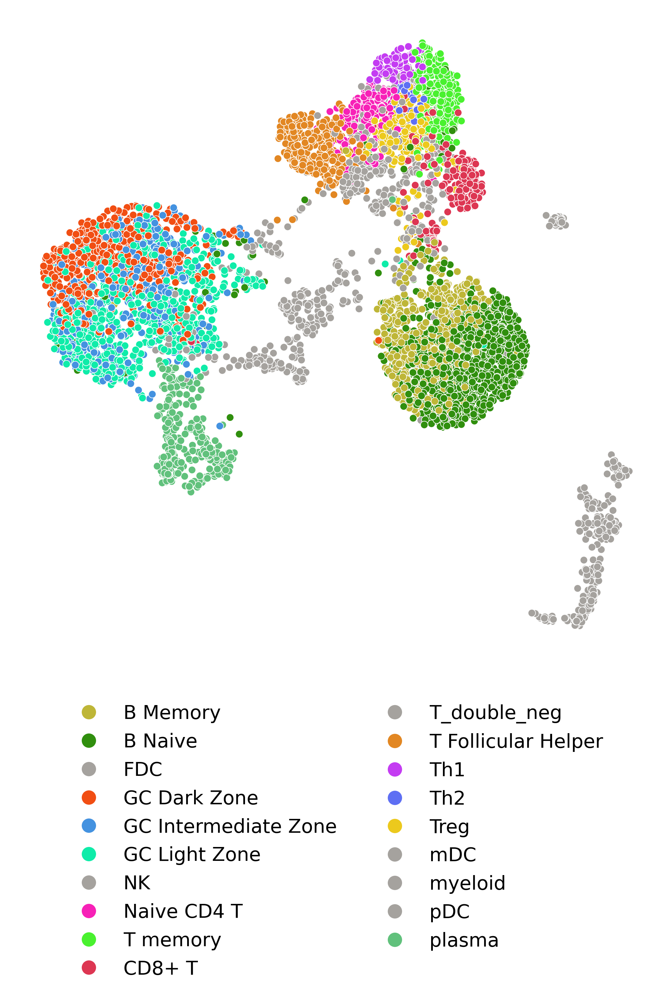

In [294]:
plt.rcParams['figure.figsize'] = (6, 6)

import alphashape

ct_points_wt = {}
for ct in adata.obs['cell_type_paper'].unique():
    points = np.asarray(
        adata[adata.obs['cell_type_paper'] == ct].obsm['spatial'])
    delta = 30
    points = np.vstack(
        (points +[-delta,delta], points +[-delta,-delta], 
        points +[delta,delta], points +[delta,-delta]))
    ct_points_wt[ct] = points

adatax = adata

sns.scatterplot(data=adatax.obs, 
    x=adatax.obsm['X_umap'][:,0], 
    y=adatax.obsm['X_umap'][:,1],
    s=15,
    hue='cell_type_2',
    legend='brief', 
    palette=color_dict
    )
plt.axis('off')

# alpha_shape = alphashape.alphashape(ct_points_wt['Germinal Center B cells'], alpha=0.035)
# for geom in alpha_shape.geoms:
#     if geom.area > 10000:
#         plt.plot(
#             geom.exterior.xy[0], 
#             geom.exterior.xy[1], 
#             color='black', alpha=1)

plt.legend(bbox_to_anchor=(0.5, -0.05), 
    loc='upper center', ncol=2, frameon=False, 
    markerscale=2, fontsize=10)

handles, labels = plt.gca().get_legend_handles_labels()
new_labels = [rename[l].replace('\n', ' ') if l in rename else l for l in labels]
plt.gca().legend(handles, new_labels, bbox_to_anchor=(0.5, -0.05), 
    loc='upper center', ncol=2, frameon=False, 
    markerscale=2, fontsize=10)


# plt.savefig('./figures/tonsil_celltypes.svg', **figure_params)
plt.show()

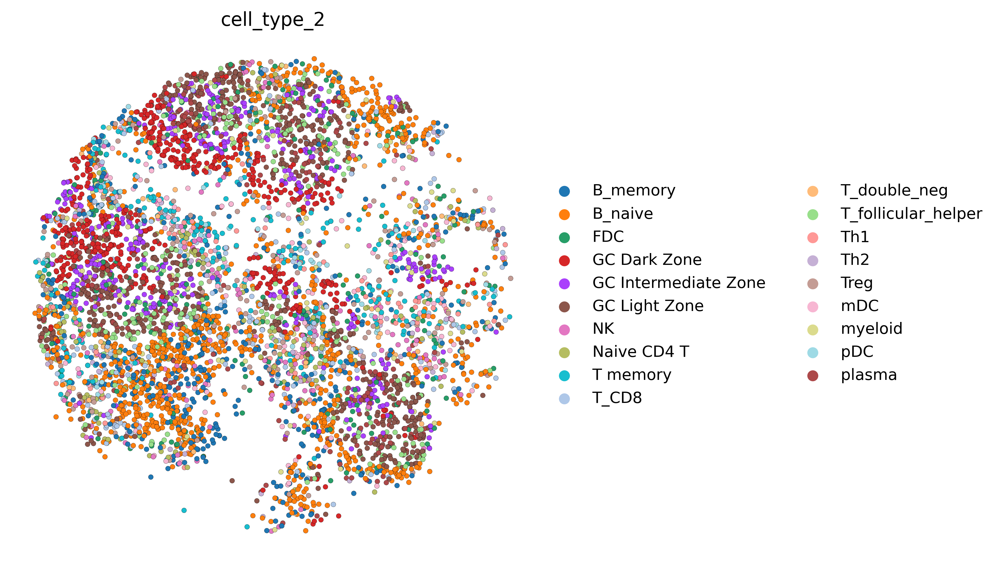

In [289]:
sc.pl.embedding(adata, show=False, basis='spatial',frameon=False, color='cell_type_2', linewidth=0.1, edgecolor='black', s=40)
plt.show()

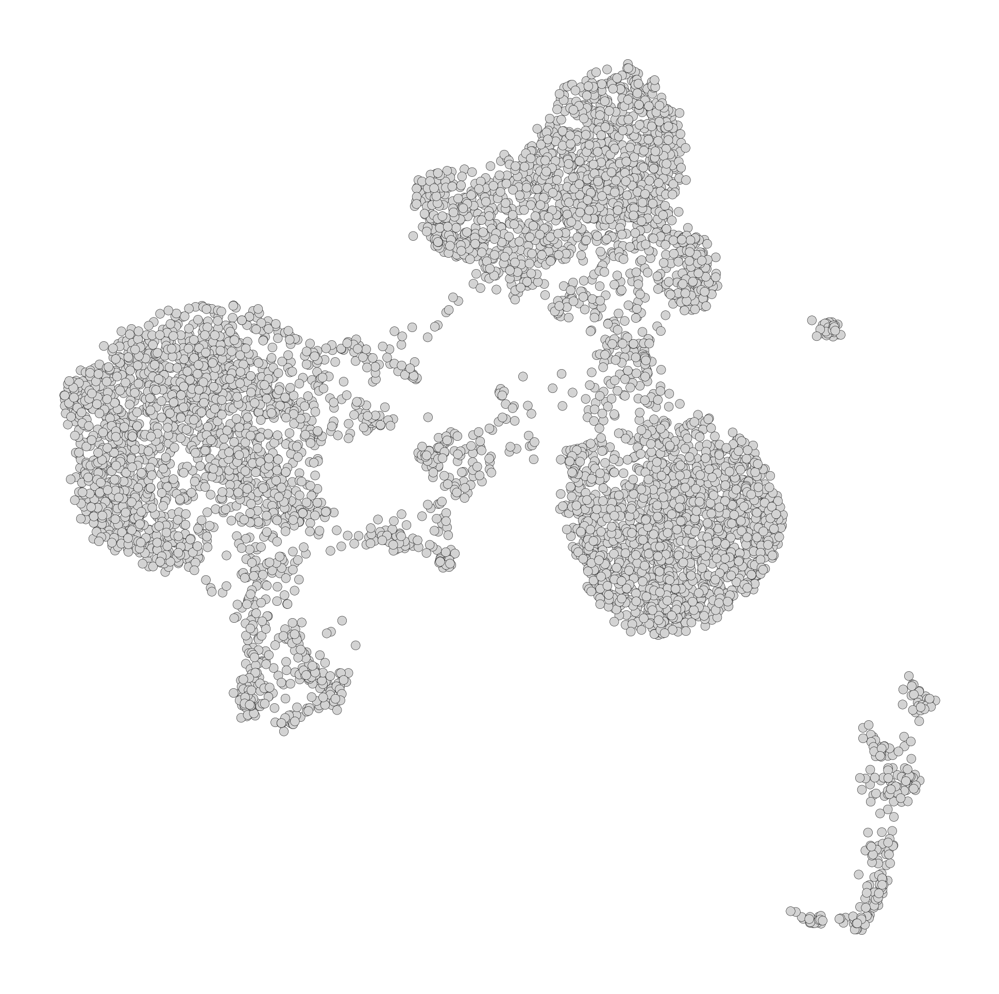

In [284]:
sc.pl.umap(adata, show=False, frameon=False, cmap='Blues', linewidth=0.1, edgecolor='black', s=40)
plt.show()

In [13]:
atmp = adata[~adata.obs.index.isin(adata.obs.iloc[[2250, 2593, 3255, 5281]].index)]
# atmp = adata[pd.read_csv('GC_selection.csv', index_col=0).index]
# atmp = adata
tonsil.init_cartography(atmp, 
    restrict_to=[
        'Naive CD4 T',
        'T_follicular_helper', 
        'Th2', 
        'Th1', 
        'Treg',
        'T_CD8',
    ]
)

In [14]:
plot_params = {
    'perturb_target': '',
    'mode': '0',
    'hue': 'cell_type_2',
    'curve': True,
    'vector_scale': 10,
    'grid_scale': 2, 
    'scale': 8,
    'grains': 25,
    'figsize': (4, 4),
    'dpi': 200,
    'scatter_size': 20,
    'legend_fontsize': 5,
    'alpha': 0.7,
    'rename': {
        'T_follicular_helper': 'T Follicular Helper',
        'T_CD8': 'T CD8+',
        'T_CD4': 'non-Tfh CD4+ T',
        'B_germinal_center': 'B Germinal Center',
        'B_naive': 'B Naive',
        'B_memory': 'B Memory',
    },
    'limit_clusters': True,
    'highlight_clusters': [
        'T_follicular_helper',
        'Th1', 
        'Th2',
        'Naive CD4 T',
        'Treg'
    ]
}

In [15]:
from sklearn.neighbors import KNeighborsRegressor

def _knn_regression(x, y, x_new, y_new, value, n_knn=30):

    data = np.stack([x, y], axis=1)

    model = KNeighborsRegressor(n_neighbors=n_knn)
    model.fit(data, value)

    data_new = np.stack([x_new, y_new], axis=1)

    return model.predict(data_new)

In [16]:
atmp = adata.copy()
atmp = atmp[atmp.obs['cell_type_2'].isin(['T_follicular_helper', 'Naive CD4 T'])]
atmp.shape, adata.shape

((477, 3333), (5778, 3333))

... storing 'cell_type_2' as categorical
... storing 'cell_type_major' as categorical


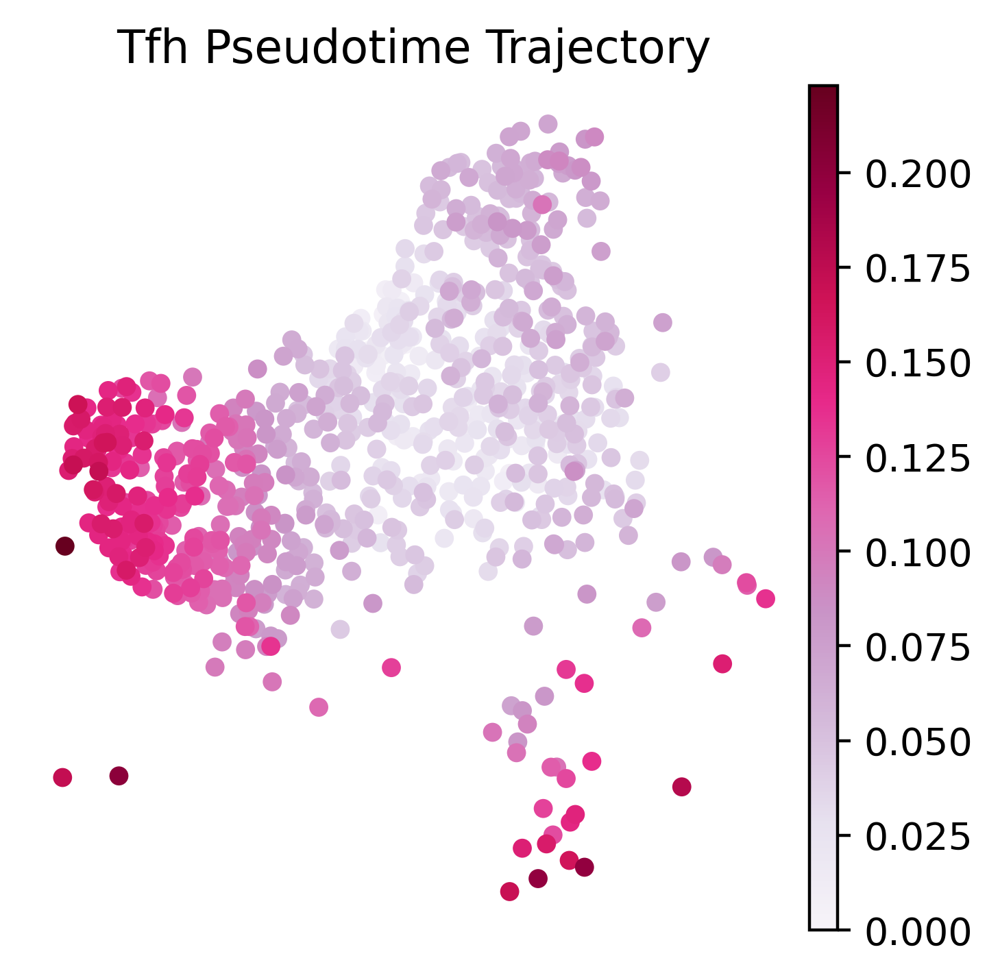

In [43]:
adata.uns['iroot'] = np.flatnonzero(adata.obs['cell_type_2'] == 'Naive CD4 T')[0]
# atmp.uns['iroot'] = np.flatnonzero(atmp.obs['cell_type_2'] == 'Naive CD4 T')[0]

mask = adata.obs['cell_type_2'].isin(['T_follicular_helper', 'Naive CD4 T', 'Treg', 'Th1', 'Th2', 'T CD8+'])

sc.tl.diffmap(adata)
sc.tl.dpt(adata, n_dcs=15, n_branchings=0)
plot = sc.pl.umap(adata[mask], 
           color=['dpt_pseudotime'], size=100, frameon=False, show=False,
           cmap='PuRd', colorbar_loc='right')
plt.title('Tfh Pseudotime Trajectory') 
# plt.savefig(
#     './figures/Tfh_pseudotime.svg',
#     **figure_params
# )
plt.show()

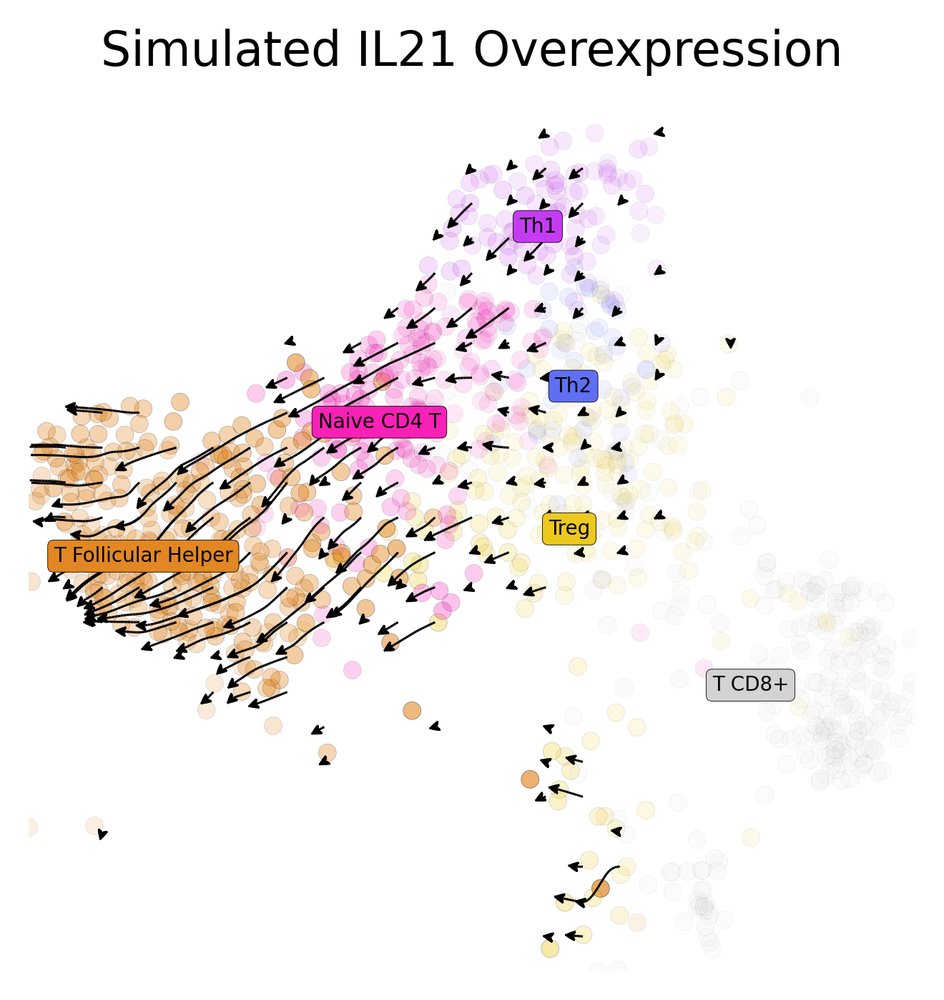

In [81]:
perturbed_df = pd.read_parquet(
    '/Volumes/SSD/genome_screens/human_tonsil/IL21_4n_maxx.parquet')

grid_points, vector_field = tonsil.plot_arrows(
    perturbed_df=perturbed_df,
    n_neighbors=200,
    **plot_params
)
plt.title('Simulated IL21 Overexpression')
plt.show()

In [99]:
adata.obs.cell_type_2.value_counts()

cell_type_2
B_naive                 1088
GC Light Zone            735
GC Dark Zone             558
B_memory                 522
GC Intermediate Zone     467
T_follicular_helper      300
FDC                      288
plasma                   283
T memory                 264
T_CD8                    244
Treg                     198
Naive CD4 T              177
NK                       170
mDC                      137
myeloid                  102
Th1                       88
pDC                       64
Th2                       47
T_double_neg              46
Name: count, dtype: int64

In [100]:
tonsil.annot

'cell_type_2'

In [10]:
perturbed_df = pd.read_parquet(
    '/Volumes/SSD/genome_screens/human_tonsil/FOXO1_4n_0x.parquet')

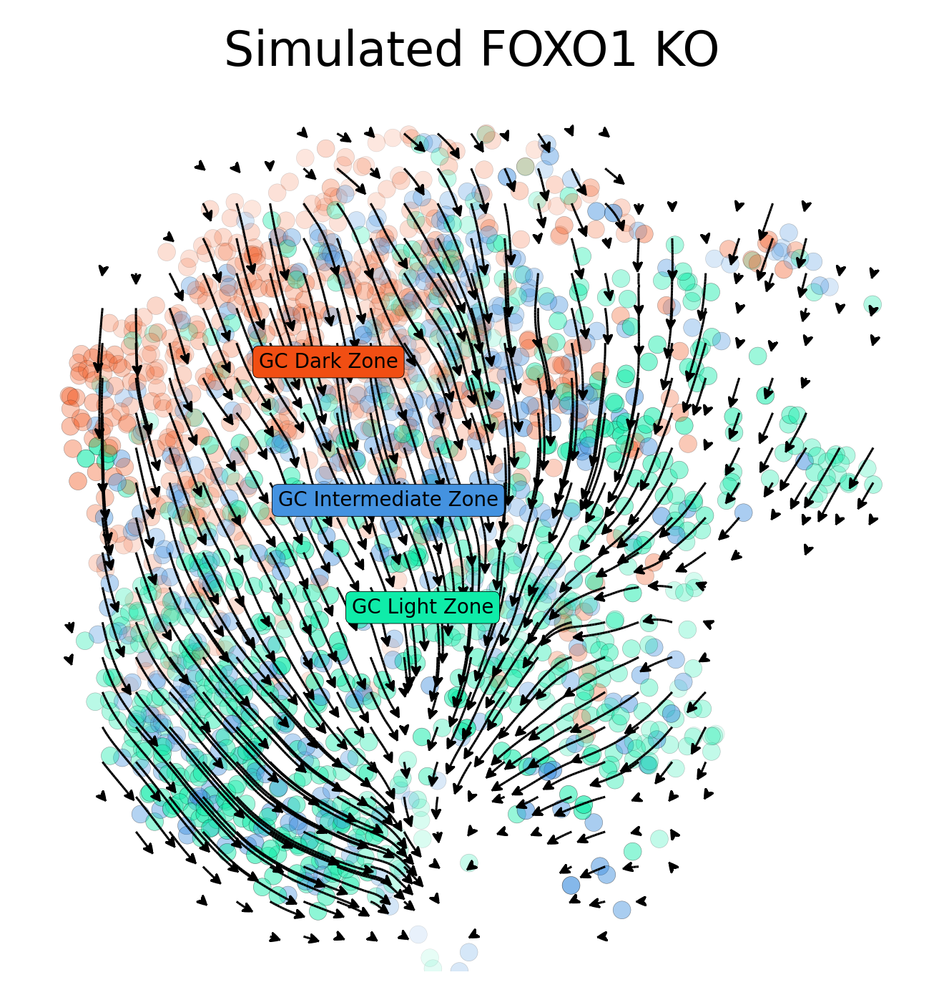

In [ ]:


# atmp = adata[~adata.obs.index.isin(adata.obs.iloc[[2250, 2593, 3255, 5281]].index)]
atmp = adata[pd.read_csv(
    '/Users/koush/Projects/SpaceOracle/notebooks/human_tonsil/GC_selection.csv', index_col=0).index]
# atmp = adata
tonsil.init_cartography(atmp, 
    restrict_to=[
        'GC Intermediate Zone',
        'GC Light Zone', 
        'GC Dark Zone', 
    ]
)
plot_params['highlight_clusters'] = [
        'GC Intermediate Zone',
        'GC Light Zone', 
        'GC Dark Zone', 
    ]
grid_points, vector_field = tonsil.plot_arrows(
    perturbed_df=perturbed_df,
    n_neighbors=200,
    **plot_params
)
plt.title('Simulated FOXO1 KO')
plt.show()

In [220]:
from spaceoracle.plotting.shift import estimate_transition_probabilities


delta_X = perturbed_df.values - adata.layers['imputed_count']
layout_embedding = adata.obsm['spatial']
n_neighbors = 60
remove_null = False
normalize = False
            
P = estimate_transition_probabilities(
    adata, delta_X, layout_embedding, n_neighbors=n_neighbors, n_jobs=1)

# if remove_null:
#     P_null = estimate_transition_probabilities(
#         adata, delta_X * 0, layout_embedding, n_neighbors=n_neighbors, n_jobs=1)
#     P = P - P_null
    
# if normalize:
#     P = (P - P.min()) / (P.max() - P.min())
#     P = P / P.sum(axis=1)[:, np.newaxis]

In [214]:
import alphashape

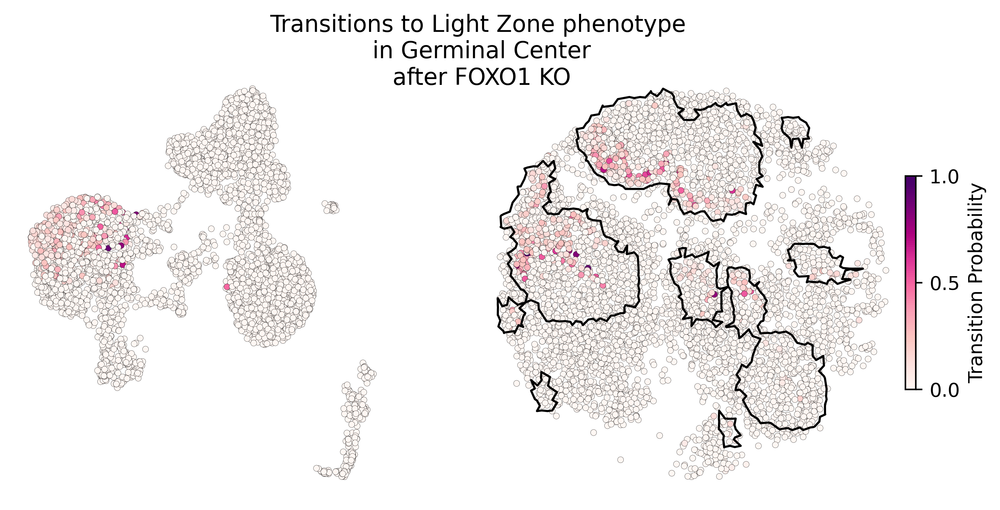

In [221]:
from_ct = adata.obs['cell_type_2'].isin(['GC Dark Zone'])
to_ct = adata.obs['cell_type_2'].isin(['GC Light Zone', 'GC Intermediate Zone'])

probs = np.zeros(adata.n_obs)
probs[from_ct] = P[from_ct][:, to_ct].max(axis=1)

adata.obs['tfh_transition_prob'] = probs
cmap = 'RdPu'
s = 10
alpha = 1
edgecolor = 'black'
linewidth = 0.1
fig, ax = plt.subplots(1, 2, figsize=(9, 4), dpi=200, width_ratios=[0.75, 1])
scatter = ax[1].scatter(
    adata.obsm['spatial'][:,0],
    adata.obsm['spatial'][:,1],
    c=adata.obs['tfh_transition_prob'],
    cmap=cmap,
    linewidth=linewidth,
    edgecolor=edgecolor,
    alpha=alpha,
    # sizes=adata.obs['tfh_transition_prob']*35,
    s=s
)

scatter = ax[0].scatter(
    adata.obsm['X_umap'][:,0],
    adata.obsm['X_umap'][:,1],
    c=adata.obs['tfh_transition_prob'],
    cmap=cmap,
    linewidth=linewidth,
    edgecolor=edgecolor,
    alpha=alpha,
    s=s
)

plt.colorbar(scatter, shrink=0.5, 
    orientation='vertical', ax=ax[1], pad=0, ticks=[0, 0.5, 1], 
    boundaries=np.linspace(0, 1, 100), label='Transition Probability')

ct_points_wt = {}
for ct in adata.obs['cell_type_paper'].unique():
    points = np.asarray(
        adata[adata.obs['cell_type_paper'] == ct].obsm['spatial'])
    delta = 30
    points = np.vstack(
        (points +[-delta,delta], points +[-delta,-delta], 
        points +[delta,delta], points +[delta,-delta]))
    ct_points_wt[ct] = points

alpha_shape = alphashape.alphashape(ct_points_wt['Germinal Center B cells'], alpha=0.035)
for geom in alpha_shape.geoms:
    if geom.area > 10000:
        ax[1].plot(
            geom.exterior.xy[0],
            geom.exterior.xy[1],
            color='black',
            alpha=1,
            linewidth=1.1
        )
        
ax[0].set_frame_on(False)
ax[1].set_frame_on(False)
ax[0].set_xticks([])
ax[0].set_yticks([])
ax[1].set_xticks([])
ax[1].set_yticks([])

plt.suptitle('Transitions to Light Zone phenotype \nin Germinal Center\nafter FOXO1 KO')
plt.axis('off')
plt.savefig(
    './figures/transition_probs.svg', 
    **figure_params)
plt.show()

In [87]:
import enlighten

In [144]:
gc_mask = adata.obs.cell_type_2.isin(['GC Dark Zone'])
gc_adata = adata[gc_mask]
umap_coords = gc_adata.obsm['X_umap']
spatial_coords = gc_adata.obsm['spatial']
trans_probs = gc_adata.obs['tfh_transition_prob'].values

umap_dists = squareform(pdist(umap_coords))
spatial_dists = squareform(pdist(spatial_coords))
prob_diffs = np.abs(trans_probs[:, None] - trans_probs[None, :])

dist_threshold = np.percentile(umap_dists, 1)
mask = np.triu(umap_dists < dist_threshold, k=1)
i_indices, j_indices = np.where(mask)

df = pd.DataFrame({
    'cell_1': gc_adata.obs_names[i_indices],
    'cell_2': gc_adata.obs_names[j_indices],
    'umap_dist': umap_dists[i_indices, j_indices],
    'spatial_dist': spatial_dists[i_indices, j_indices],
    'prob_diff': prob_diffs[i_indices, j_indices]
})

In [145]:
df = df.sort_values(by='umap_dist', ascending=True).head(30)
df

,cell_1,cell_2,umap_dist,spatial_dist,prob_diff
681,CCCTGATCAGAAATTG-1,TCCTTTCTCTCGACCT-1,0.007060,893.460342,0.016516
810,CTACTATCAATATCCG-1,GTTCGCTCACCATATG-1,0.008295,357.768221,0.049316
761,CGAAGGAAGATGTTGA-1,GTCACGGCATCCGGCA-1,0.012486,658.238953,0.242200
593,CATCCACCAGGCAATG-1,TGAGGGATCTCTGGTC-1,0.012714,1079.922686,0.091527
15,AAAGGTATCCAAACCA-1,CACAGGCAGAGTCGAC-1,0.013239,518.179379,0.008146
1254,TGAGGTTTCAATGTCG-1,TGGCGTGCACTATCGA-1,0.013962,540.558082,0.694424
758,CCTTTGGAGCTGACCC-1,GTCTACCGTGTCATGT-1,0.014312,133.906951,0.371483
819,CTAGACAGTGACCGTC-1,TTGCCTGAGGAGATAG-1,0.015779,1784.215883,0.252342
928,CTTTCAAGTCATCAGT-1,TAAGCCAGTCTCCTGT-1,0.016052,1441.738442,0.267248
767,CGATGGCTCGACGCGT-1,CTCATGCGTCGTATGT-1,0.017761,440.483592,0.015427


In [119]:
highlight_cells = ['GAGTGTTGTTGTCTAG-1', 'GTTCCGTCATGACTGT-1']


In [120]:
df.spatial_dist.mean()

679.4224770674316

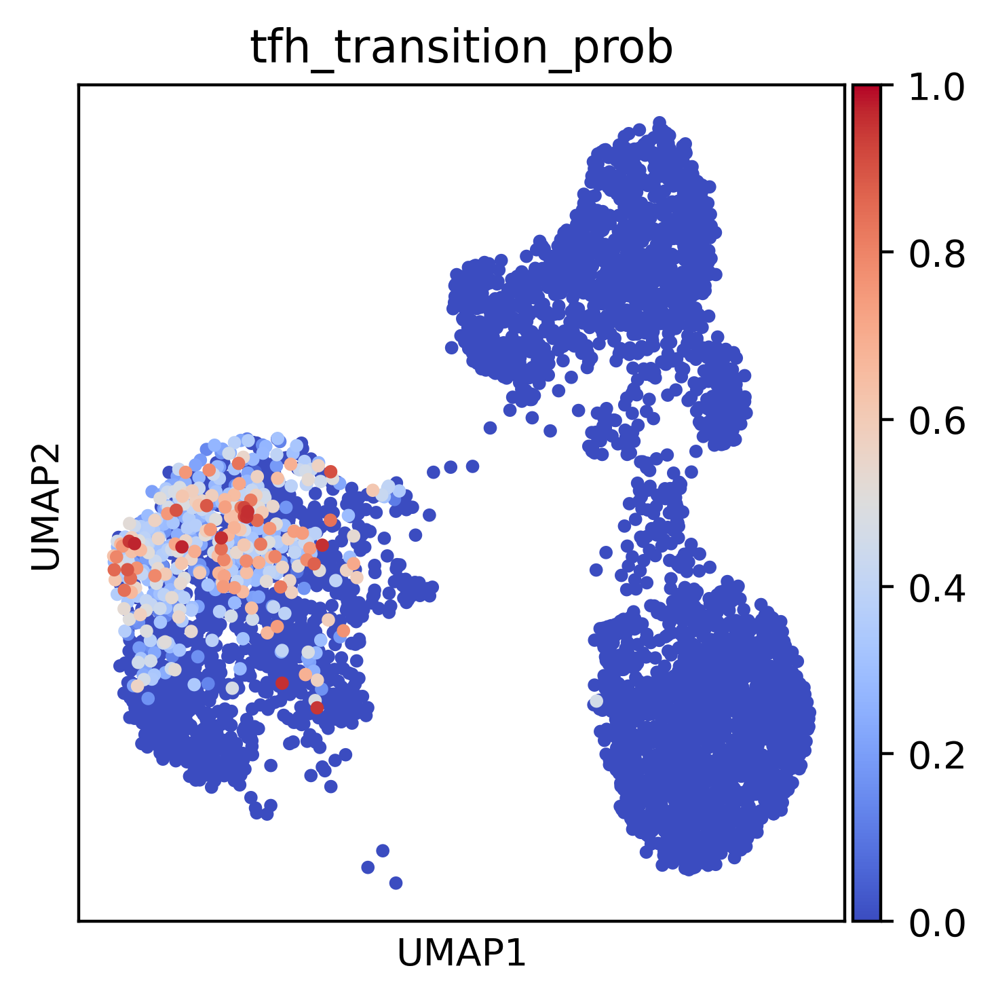

In [168]:

sc.pl.embedding(
    atmp,
    basis='umap', 
    color='tfh_transition_prob',
    cmap='coolwarm',
    size=50,
    show=True,
    vmax=1, vmin=0
)

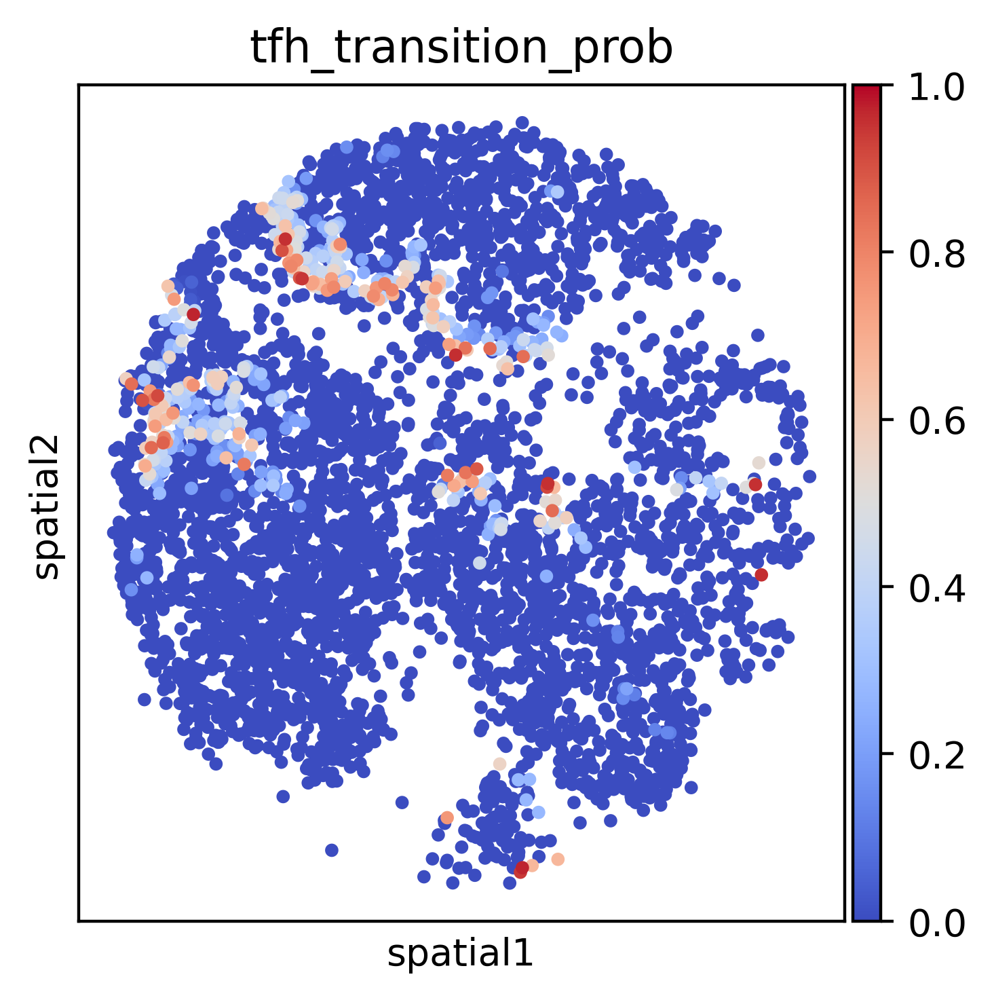

In [169]:

sc.pl.embedding(
    atmp,
    basis='spatial', 
    color='tfh_transition_prob',
    cmap='coolwarm',
    size=50,
    show=True,
    vmax=1, vmin=0
)

... storing 'cell_type_2' as categorical
... storing 'cell_type_major' as categorical
... storing 'cell_type_paper' as categorical


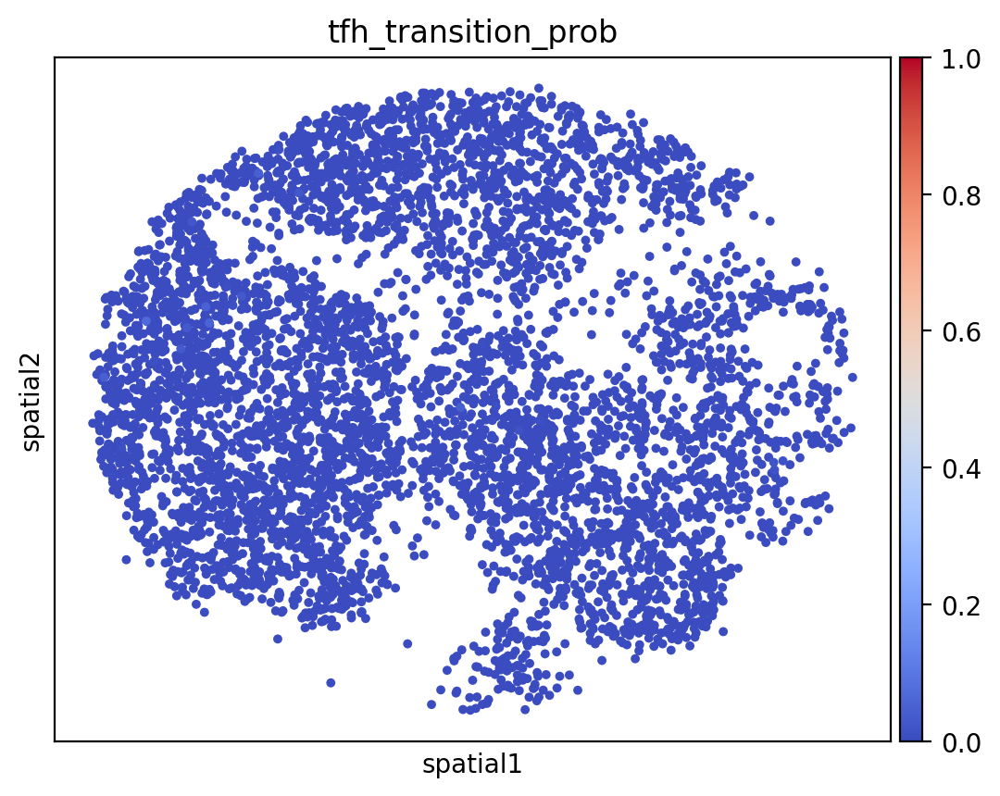

In [20]:
to_ct = adata.obs['cell_type_2'] == 'GC Dark Zone'
from_ct = adata.obs['cell_type_2'].isin(['GC Light Zone', 'GC Intermediate Zone'])


probs = np.zeros(adata.n_obs)
probs[from_ct] = P[from_ct][:, to_ct].max(axis=1)

# tfh_probs = (probs - probs.min()) / (probs.max() - probs.min())

adata.obs['tfh_transition_prob'] = probs

sc.pl.embedding(
    adata,
    basis='spatial', 
    color='tfh_transition_prob',
    cmap='coolwarm',
    size=50,
    show=True,
    vmax=1, vmin=0
)


In [45]:
atmp.uns['iroot'] = np.flatnonzero(atmp.obs['cell_type_2'] == 'Naive CD4 T')[0]

sc.tl.diffmap(atmp)
sc.tl.dpt(atmp, n_dcs=15, n_branchings=0)

In [57]:
plt.rcParams['figure.figsize'] = (4, 4)
plt.rcParams['figure.dpi'] = 200

# embedding = adata[atmp.obs['cell_type_2'].isin(['T_follicular_helper', 'Naive CD4 T'])].obsm['X_umap']
# embedding = adata.obsm['X_umap']
embedding = atmp.obsm['X_umap']

x, y = embedding[:, 0], embedding[:, 1]
x_new, y_new = grid_points[:, 0], grid_points[:, 1]

value = np.clip(atmp.obs.dpt_pseudotime.values, 0, 1)
# value = atmp.to_df(layer='imputed_count')['IL21'].values

# value = atmp[atmp.obs['cell_type_2'].isin(['Naive CD4 T'])].obs.dpt_pseudotime.values
# value = atmp[atmp.obs['cell_type_2'].isin(['T_follicular_helper', 'Naive CD4 T'])].obs.dpt_pseudotime.values


pseudotime_on_grid = _knn_regression(x, y, x_new, y_new, value, n_knn=200)
gradient = get_gradient(value_on_grid=pseudotime_on_grid)
gradient = normalize_gradient(gradient, method="sqrt")
l2_norm = np.linalg.norm(gradient, ord=2, axis=1)
scale_factor = 1 / l2_norm.mean()
# ref_flow = gradient * -2
ref_flow = gradient * 2

zero_mask = (vector_field[:,0] == 0) & (vector_field[:,1] == 0)
ref_flow[zero_mask] = 0

inner_product = np.sum(vector_field * ref_flow, axis=1)

# Get cell type for each grid point using nearest neighbor
from sklearn.neighbors import NearestNeighbors
nn = NearestNeighbors(n_neighbors=1)
nn.fit(adata.obsm['X_umap'])
grid_cell_idx = nn.kneighbors(grid_points, return_distance=False)[:,0]
grid_cell_types = adata.obs.cell_type_2.values[grid_cell_idx]

# Calculate mean inner product per cell type
cell_type_inner_products = {}
for cell_type in adata.obs.cell_type_2.unique():
    mask = grid_cell_types == cell_type
    if mask.any():
        mean_val = inner_product[mask].mean()
        if abs(mean_val) > 1e-10:  # Filter out effectively zero values
            cell_type_inner_products[cell_type] = mean_val

# Sort by absolute value
cell_type_inner_products = dict(sorted(cell_type_inner_products.items(), 
                                     key=lambda x: abs(x[1]), 
                                     reverse=True))

cell_types = list(cell_type_inner_products.keys())
values = list(cell_type_inner_products.values())

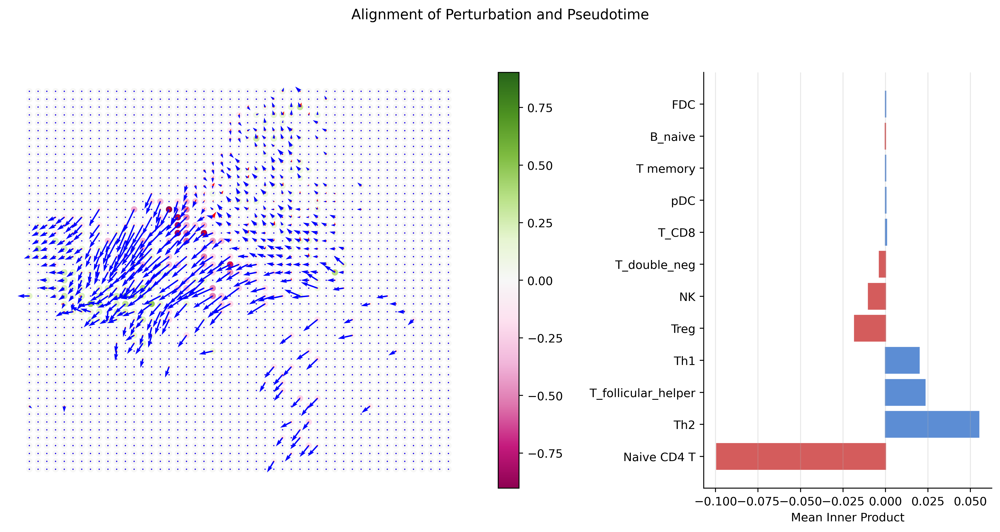

In [58]:

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 6), dpi=200, width_ratios=[2, 1])

# Left plot - scatter with vectors
vmax = np.abs(inner_product).max()
scatter = ax1.scatter(grid_points[:,0], grid_points[:,1], 
                    c=inner_product, cmap='PiYG', s=20,
                    vmin=-vmax, vmax=vmax)

ax1.quiver(grid_points[:,0], grid_points[:,1],
          vector_field[:,0], vector_field[:,1],
          angles='xy', scale_units='xy', scale=100,
          alpha=1, color='red', width=0.003)

ax1.quiver(grid_points[:,0], grid_points[:,1],
          ref_flow[:, 0], ref_flow[:, 1], 
          angles='xy', scale_units='xy', scale=0.5,
          alpha=1, color='blue', width=0.003)

ax1.set_frame_on(False)
ax1.set_xticks([])
ax1.set_yticks([])
plt.colorbar(scatter, ax=ax1)

# Right plot - bar chart
cell_types = list(cell_type_inner_products.keys())
values = list(cell_type_inner_products.values())
y_pos = np.arange(len(cell_types))

bars = ax2.barh(y_pos, values)
ax2.set_yticks(y_pos)
ax2.set_yticklabels(cell_types)
ax2.set_xlabel('Mean Inner Product')

# Color bars based on sign
for i, bar in enumerate(bars):
    if values[i] < 0:
        bar.set_color('#d45c5c')
    else:
        bar.set_color('#5c8dd4')

ax2.spines['top'].set_visible(False)
ax2.spines['right'].set_visible(False)
ax2.grid(True, axis='x', alpha=0.3)

plt.suptitle('Alignment of Perturbation and Pseudotime', y=1.05)
plt.tight_layout()
plt.show()

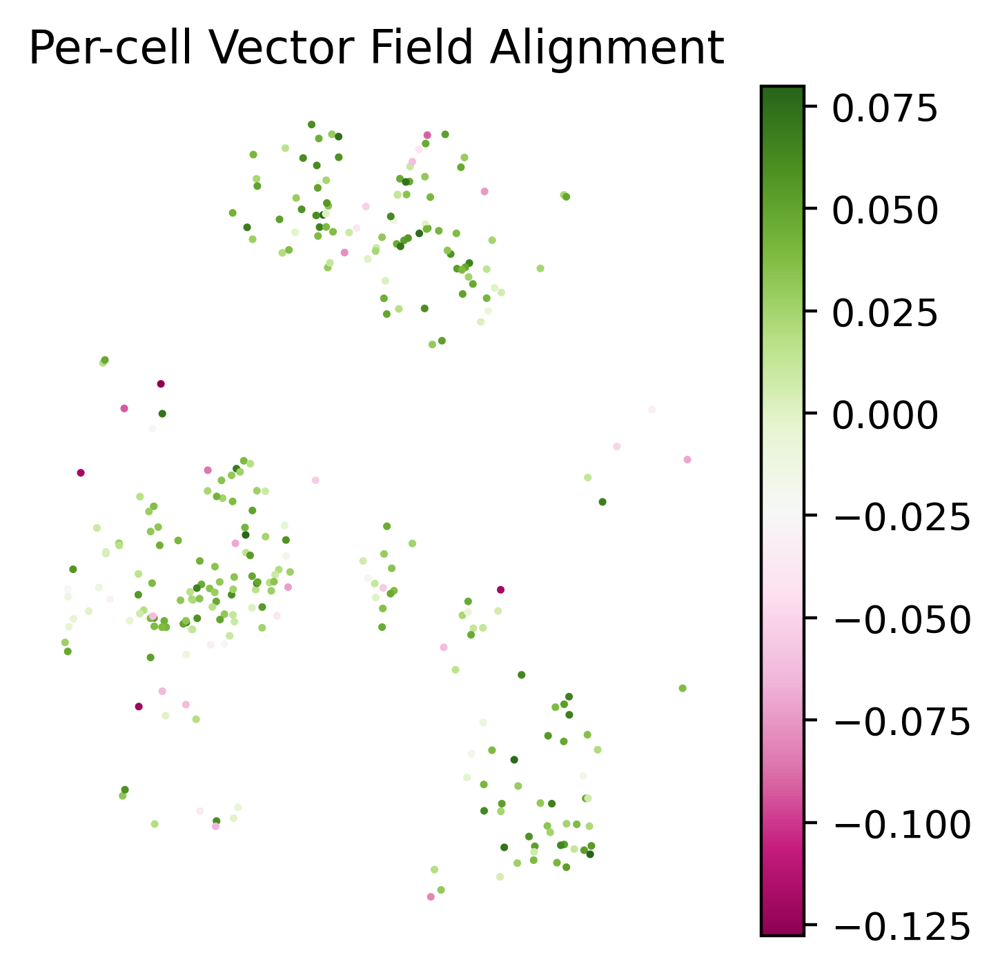

In [64]:
# Calculate inner product per cell
cell_vector_field_x = _knn_regression(grid_points[:,0], grid_points[:,1], 
                                    x, y, vector_field[:,0], n_knn=100)
cell_vector_field_y = _knn_regression(grid_points[:,0], grid_points[:,1], 
                                    x, y, vector_field[:,1], n_knn=100)
cell_vector_field = np.stack([cell_vector_field_x, cell_vector_field_y], axis=1)

cell_ref_flow_x = _knn_regression(grid_points[:,0], grid_points[:,1],
                                 x, y, ref_flow[:,0], n_knn=100)
cell_ref_flow_y = _knn_regression(grid_points[:,0], grid_points[:,1],
                                 x, y, ref_flow[:,1], n_knn=100)
cell_ref_flow = np.stack([cell_ref_flow_x, cell_ref_flow_y], axis=1)

cell_inner_product = np.sum(cell_vector_field * cell_ref_flow, axis=1)

plt.figure(figsize=(4,4))
# plt.scatter(x, y, c=cell_inner_product, cmap='PiYG', s=1)
# plt.scatter(atmp.obsm['X_umap'][:,0], atmp.obsm['X_umap'][:,1], c=cell_inner_product, cmap='viridis', s=1)
plt.scatter(
    atmp[atmp.obs['cell_type_2'].isin(['T_follicular_helper'])].obsm['spatial'][:,0], 
    atmp[atmp.obs['cell_type_2'].isin(['T_follicular_helper'])].obsm['spatial'][:,1], 
    c=cell_inner_product[atmp.obs['cell_type_2'].isin(['T_follicular_helper'])], 
    cmap='PiYG', 
    s=1
)


plt.colorbar()
plt.axis('off')
plt.title('Per-cell Vector Field Alignment')
plt.show()


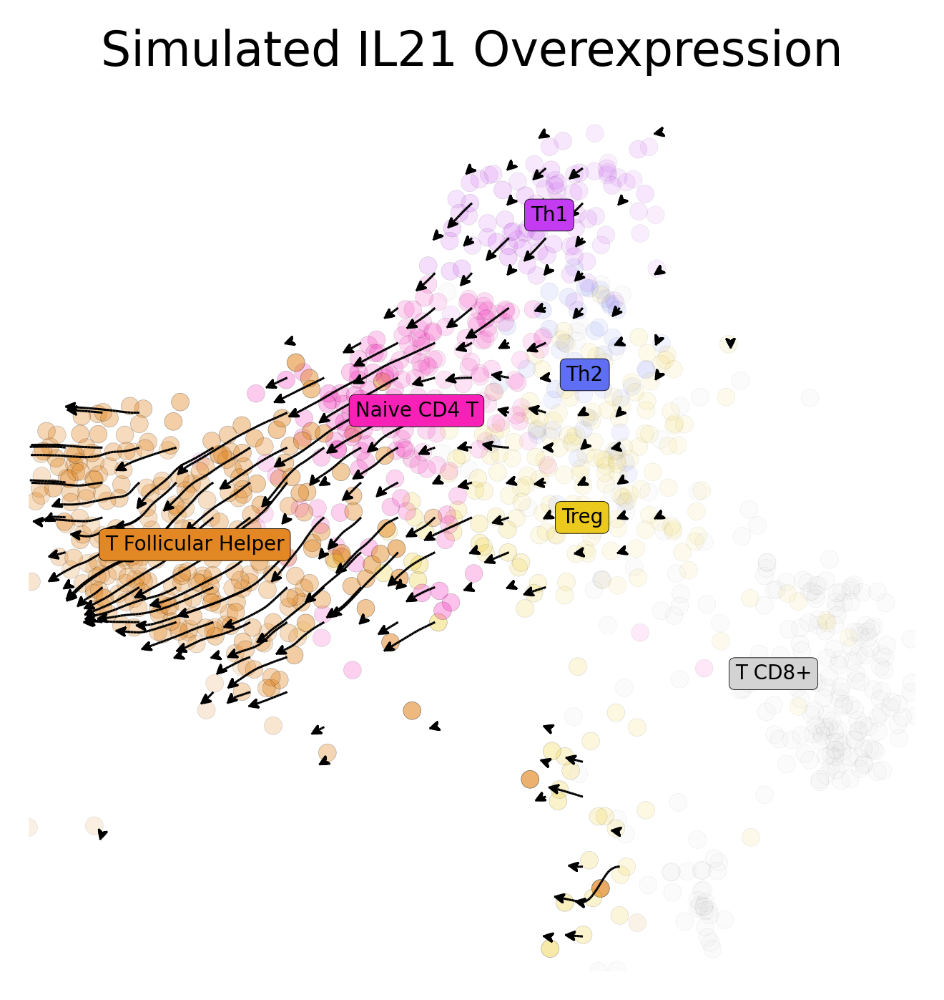

In [658]:
perturbed_df = pd.read_parquet(
    '/Volumes/SSD/genome_screens/human_tonsil/IL21_4n_maxx.parquet')

grid_points, vector_field = tonsil.plot_arrows(
    perturbed_df=perturbed_df,
    n_neighbors=200,
    **plot_params
)
plt.title('Simulated IL21 Overexpression')
plt.savefig(
    './figures/IL21_OVX.svg', 
    **figure_params
)
plt.show()

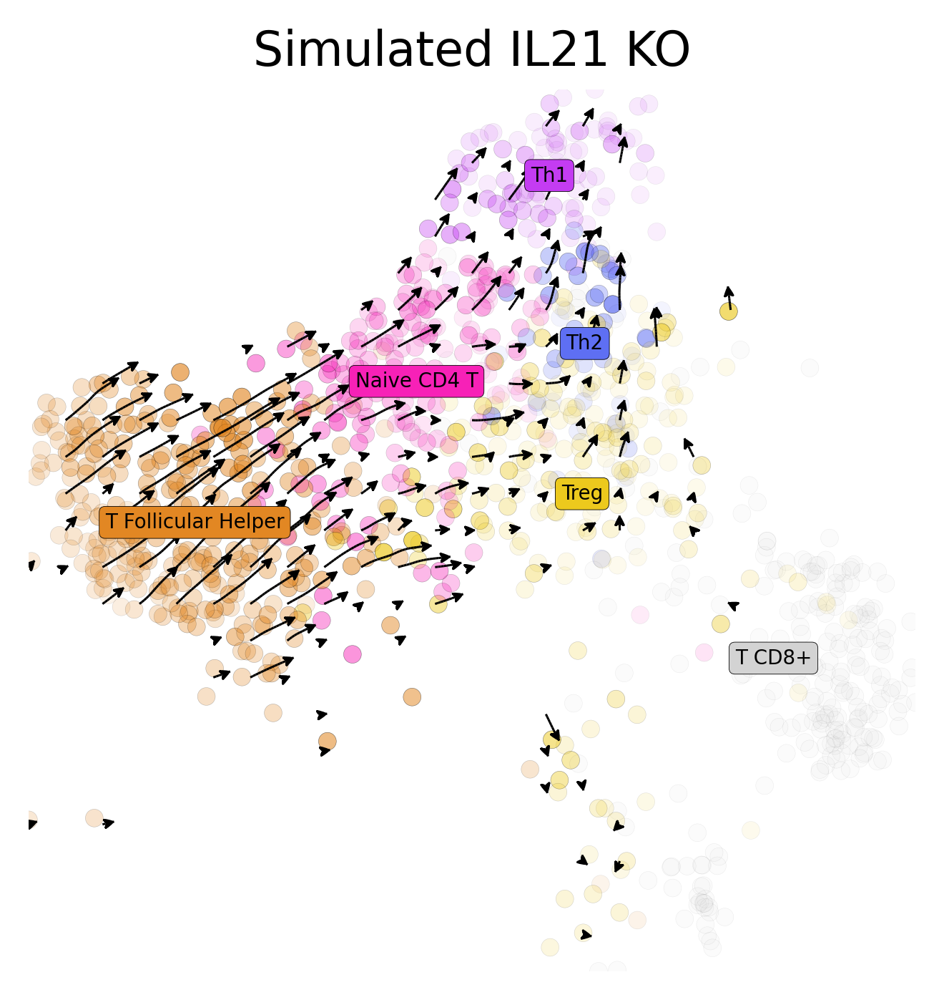

In [881]:
perturbed_df = pd.read_parquet(
    '/Volumes/SSD/genome_screens/human_tonsil/IL21_4n_0x.parquet')

grid_points, vector_field = tonsil.plot_arrows(
    perturbed_df=perturbed_df,
    n_neighbors=200,
    **plot_params
)
plt.title('Simulated IL21 KO')
plt.savefig(
    './figures/IL21_KO.svg', 
    **figure_params
)
plt.show()

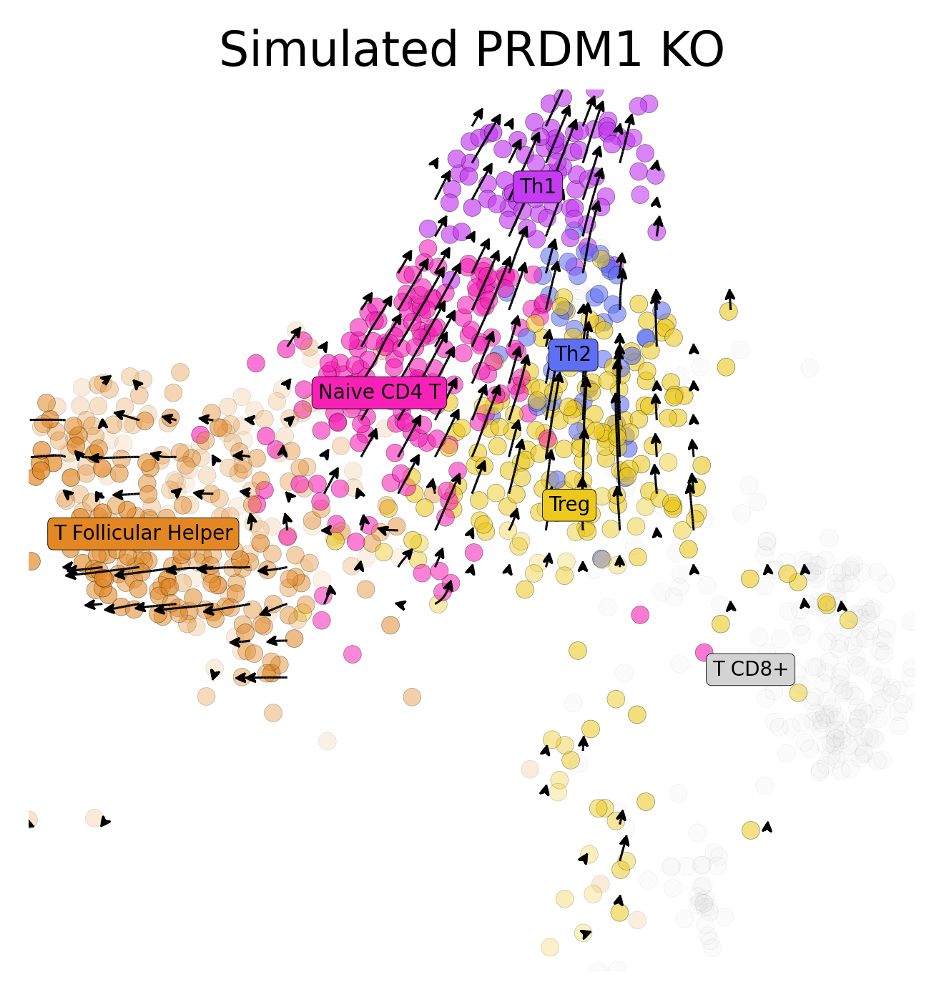

In [56]:
perturbed_df = pd.read_parquet(
    '/Volumes/SSD/genome_screens/human_tonsil/PRDM1_4n_0x.parquet')

grid_points, vector_field = tonsil.plot_arrows(
    perturbed_df=perturbed_df,
    n_neighbors=800,
    **plot_params
)

plt.title('Simulated PRDM1 KO')

# plt.savefig(
#     './figures/PRDM1_KO.svg', 
#     **figure_params
# )
plt.show()

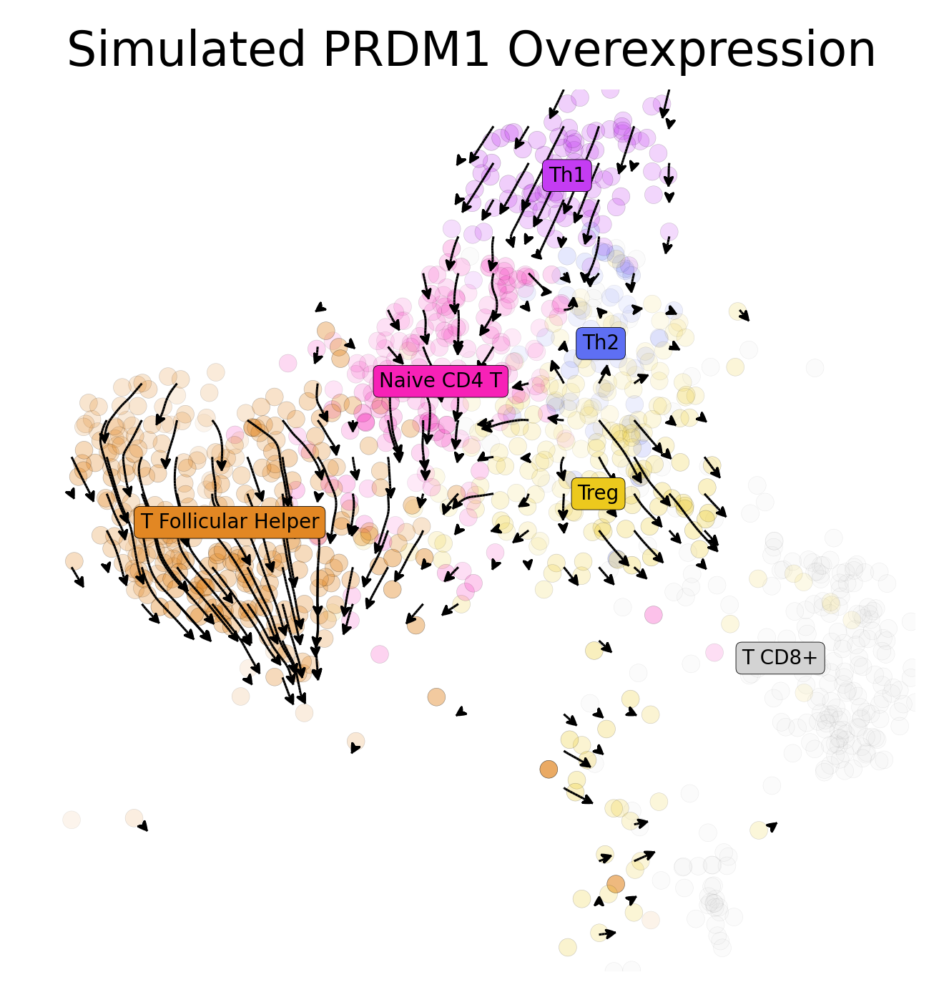

In [732]:
perturbed_df = pd.read_parquet(
    '/Volumes/SSD/genome_screens/human_tonsil/PRDM1_4n_maxx.parquet')

grid_points, vector_field = tonsil.plot_arrows(
    perturbed_df=perturbed_df,
    n_neighbors=150,
    **plot_params
)

plt.title('Simulated PRDM1 Overexpression')
plt.savefig(
    './figures/PRDM1_OVX.svg', 
    **figure_params
)
plt.show()

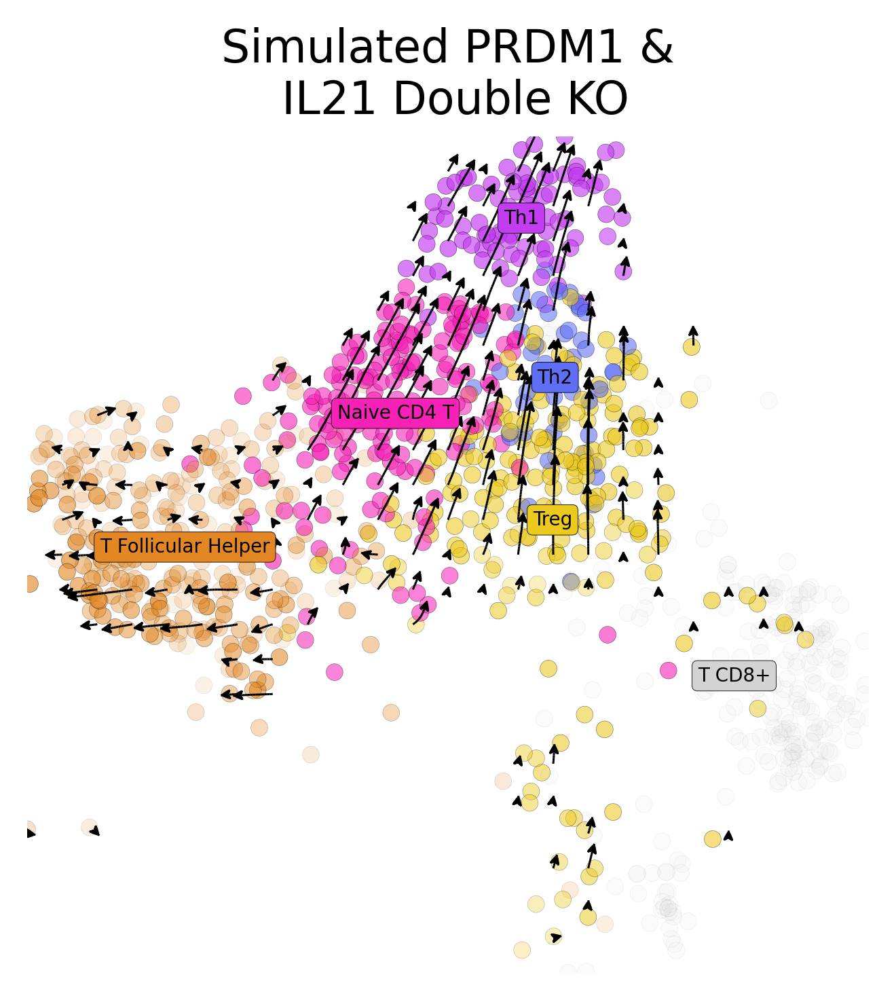

In [379]:
perturbed_df = pd.read_parquet(
    '/Volumes/SSD/genome_screens/human_tonsil/PRDM1_4n_0x_IL21_0x.parquet')

grid_points, vector_field = tonsil.plot_arrows(
    perturbed_df=perturbed_df,
    n_neighbors=850,
    **plot_params
)

plt.title('Simulated PRDM1 &\n IL21 Double KO')
plt.savefig(
    './figures/PRDM1_KO_IL21_KO.svg', 
    **figure_params
)
plt.show()

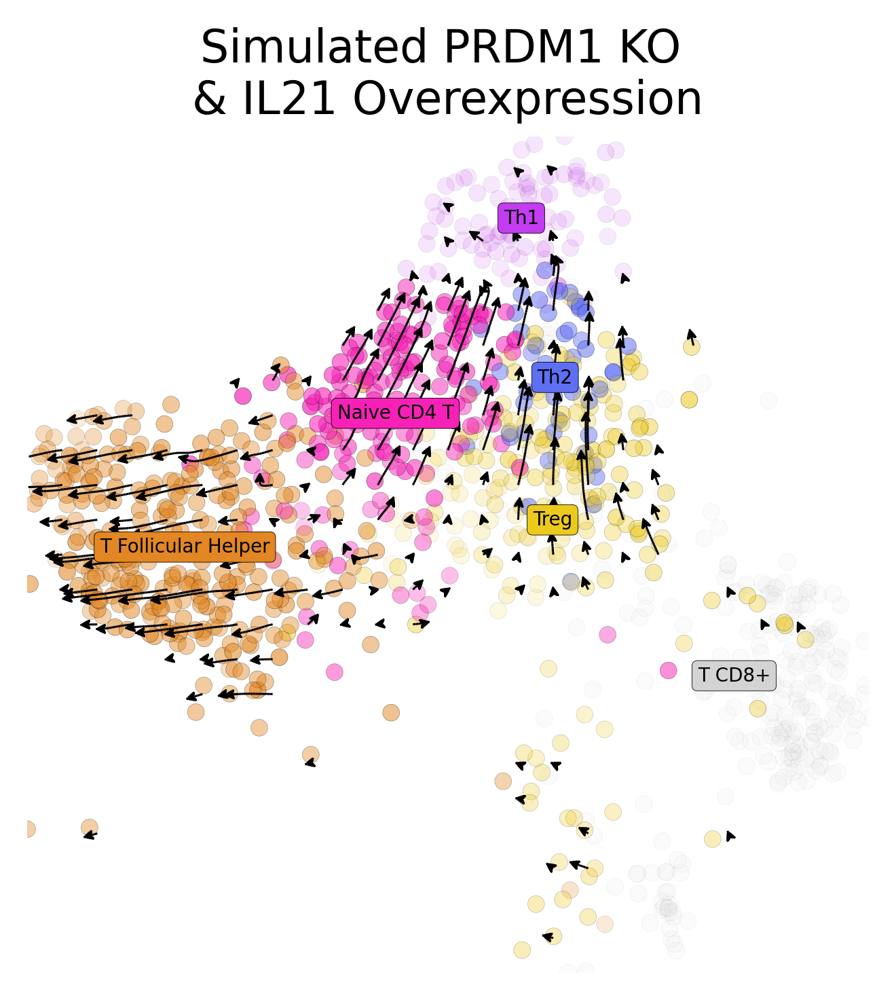

In [649]:
# perturbed_df = pd.read_parquet(
#     '/Volumes/SSD/genome_screens/human_tonsil/PRDM1_4n_0x_IL21_maxx.parquet')
perturbed_df = pd.read_parquet(
    '/tmp/PRDM1_4n_0x_IL21_maxx.parquet')

grid_points, vector_field = tonsil.plot_arrows(
    perturbed_df=perturbed_df,
    n_neighbors=600,
    **plot_params
)

plt.title('Simulated PRDM1 KO \n& IL21 Overexpression')
plt.savefig(
    './figures/PRDM1_KO_IL21_OVX.svg', 
    **figure_params
)
plt.show()

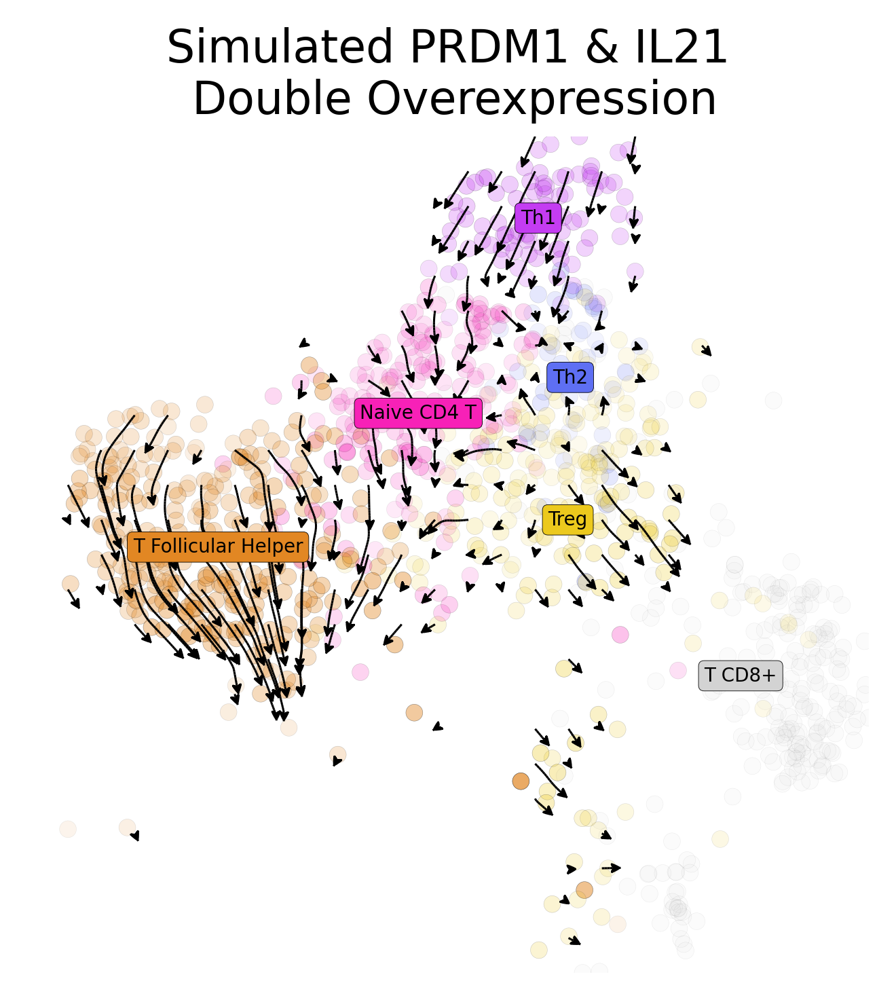

In [735]:
perturbed_df = pd.read_parquet(
    '/Volumes/SSD/genome_screens/human_tonsil/PRDM1_4n_maxx_IL21_maxx.parquet')

grid_points, vector_field = tonsil.plot_arrows(
    perturbed_df=perturbed_df,
    n_neighbors=150,
    **plot_params
)
plt.title('Simulated PRDM1 & IL21\n Double Overexpression')
plt.savefig(
    './figures/PRDM1_OVX_IL21_OVX.svg', 
    **figure_params
)
plt.show()

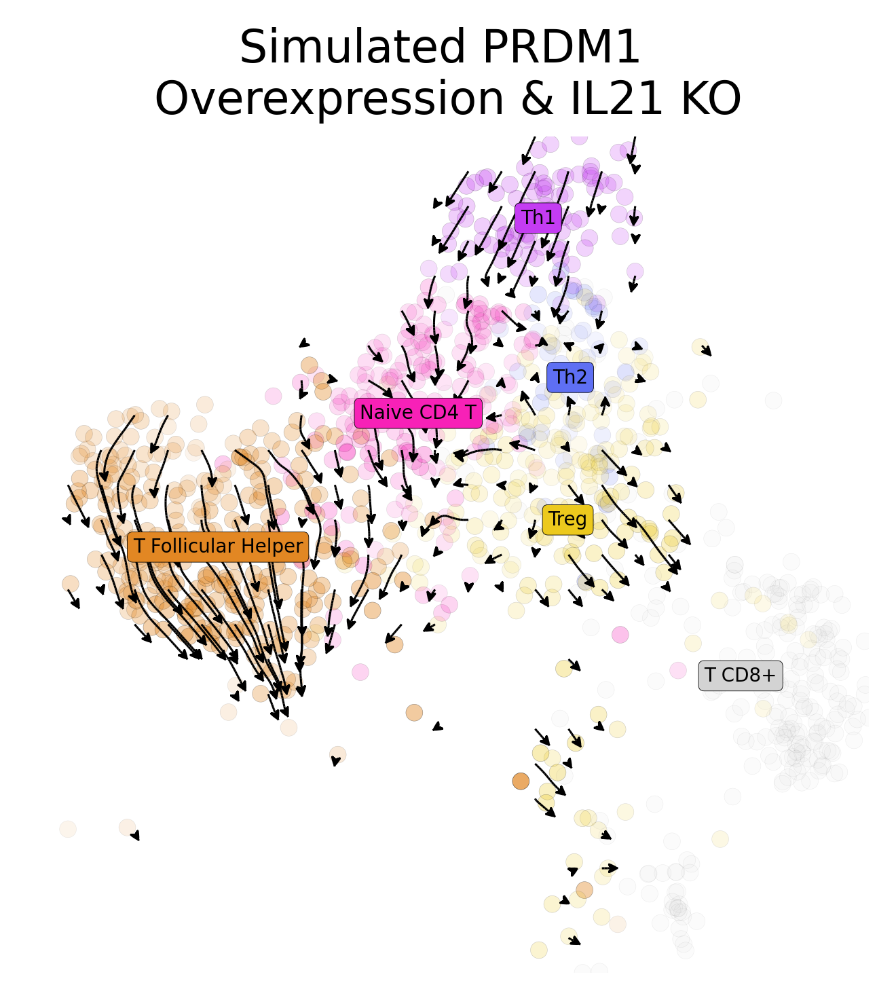

In [723]:
perturbed_df = pd.read_parquet(
    '/Volumes/SSD/genome_screens/human_tonsil/PRDM1_4n_maxx_IL21_0x.parquet')

grid_points, vector_field = tonsil.plot_arrows(
    perturbed_df=perturbed_df,
    n_neighbors=150,
    **plot_params
)
plt.title('Simulated PRDM1 \nOverexpression & IL21 KO')
plt.savefig(
    './figures/PRDM1_OVX_IL21_KO.svg', 
    **figure_params
)
plt.show()

In [183]:
from spaceoracle.models.parallel_estimators import create_spatial_features
from scipy.stats import pearsonr
from spaceoracle.plotting.cartography import xy_from_adata

In [184]:
def plot_gene_vs_proximity(perturb_target, perturbed_df, gene, color_gene, cell_filter, 
                          proximity_threshold=150, gene_threshold=0.005, ax=None, mode='ko'):
    # perturbed_df = pd.read_parquet(
    #     f'/Volumes/SSD/genome_screens/human_tonsil/{perturb_target}_4n_maxx.parquet')
    
    datadf = spf[
        [i+'_within' for i in cell_groups['GC B Cells']
            ]].sum(1).to_frame().join(adata.obs.cell_type_2).query(
             f'cell_type_2.isin(["{cell_filter}"])').join(xy).join(
        ((perturbed_df-adata.to_df(layer='imputed_count'))/adata.to_df(layer='imputed_count'))*100
    )
    datadf = datadf[datadf[0] < proximity_threshold]
    
    if ax is None:
        ax = plt.gca()
    
    try:
        corr = pearsonr(datadf[datadf[gene]>gene_threshold][0], datadf[datadf[gene]>gene_threshold][gene]).statistic
        ax.set_title(f"{perturb_target} {mode} in\n{cell_filter}\nCorrelation: {corr:.4f}")
    except:
        corr = 0
        ax.set_title(f"{perturb_target} {mode} in\n{cell_filter}\nCorrelation: NaN")
        
    scatter = ax.scatter(
        datadf[0], 
        datadf[gene], 
        c=datadf[color_gene],
        cmap='rainbow',
    )
    cbar = plt.colorbar(scatter, label=f'{color_gene} % change', shrink=0.5, ax=ax, format='%.2f')
    cbar.ax.tick_params(labelsize=10)
    cbar.set_label(f'{color_gene} % change', fontsize=12)
    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)
    ax.set_ylabel(f'{gene} % change', fontsize=14)    
    ax.set_xlabel(f'Number of GC B cells within {RADIUS}um', fontsize=14)
    
    return ax, datadf

In [185]:
adata = sc.read_h5ad('/Volumes/SSD/training_data/snrna_human_tonsil.h5ad')
adata.obsm['X_umap'] = pd.read_csv('../../notebooks/human_tonsil/umap.csv', index_col=0).values
adata.obs = adata.obs.join(pd.read_csv('../../notebooks/human_tonsil/tonsil_cell_types.csv', index_col=0))

adata.layers['imputed_count'] = np.load('../../notebooks/human_tonsil/imputed_counts.npy')

RADIUS = 200

xy = xy_from_adata(adata)

spf = create_spatial_features(
    x=adata.obsm['spatial'][:, 0], 
    y=adata.obsm['spatial'][:, 1], 
    celltypes=adata.obs.cell_type_2, 
    obs_index=adata.obs_names,
    radius = RADIUS
)

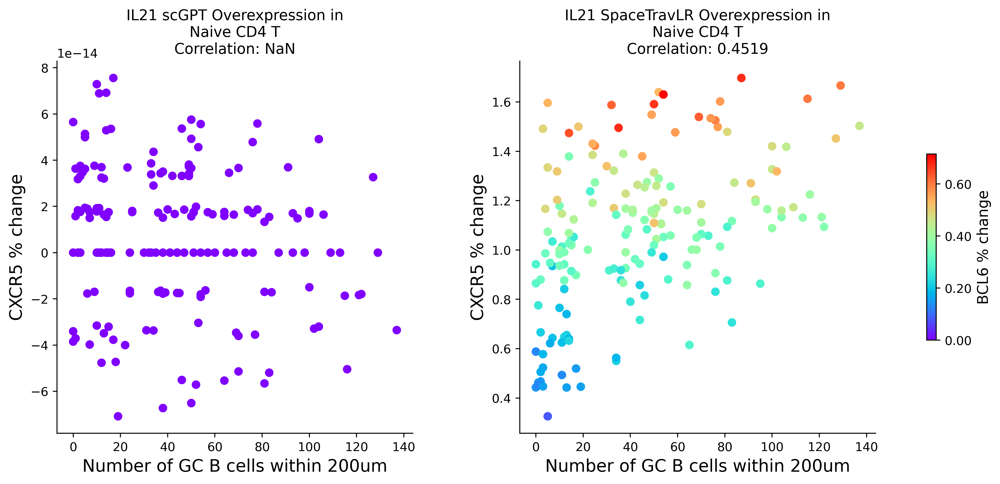

In [197]:
plt.rcParams['figure.figsize'] = (7, 6)
plt.rcParams['figure.dpi'] = 100

f, axs = plt.subplots(1, 2, figsize=(15, 5.5), dpi=200)
plt.subplots_adjust(wspace=0.3)

perturbed_df = pd.read_parquet(
    '/Volumes/SSD/genome_screens/human_tonsil_scGPT/IL21_4n_maxx.parquet'
)

ax1, df1 = plot_gene_vs_proximity(
    perturb_target='IL21',
    perturbed_df=perturbed_df, 
    mode='scGPT Overexpression',
    gene='CXCR5', 
    color_gene='BCL6', 
    cell_filter='Naive CD4 T', 
    ax=axs[0]
)

perturbed_df = pd.read_parquet(
    '/Volumes/SSD/genome_screens/human_tonsil/IL21_4n_maxx.parquet'
)

ax2, df2 = plot_gene_vs_proximity(
    perturb_target='IL21',
    perturbed_df=perturbed_df, 
    mode='SpaceTravLR Overexpression',
    gene='CXCR5', 
    color_gene='BCL6', 
    cell_filter='Naive CD4 T', 
    ax=axs[1]
)
color_gene = 'BCL6'
vmin = min(df1[color_gene].min(), df2[color_gene].min())
vmax = max(df1[color_gene].max(), df2[color_gene].max())

for ax in axs:
    if ax.collections:
        for collection in ax.collections:
            if hasattr(collection, 'colorbar'):
                collection.colorbar.remove()

scatter = axs[1].scatter([], [], c=[], cmap='rainbow', vmin=vmin, vmax=vmax)
cbar = plt.colorbar(scatter, ax=axs, label=f'BCL6 % change', shrink=0.5, format='%.2f')
cbar.ax.tick_params(labelsize=10)
cbar.set_label(f'BCL6 % change', fontsize=12)

for ax in axs:
    ax.collections[0].set_clim(vmin, vmax)
plt.savefig(
    './figures/proximity_b.svg', 
    **figure_params
)
plt.show()

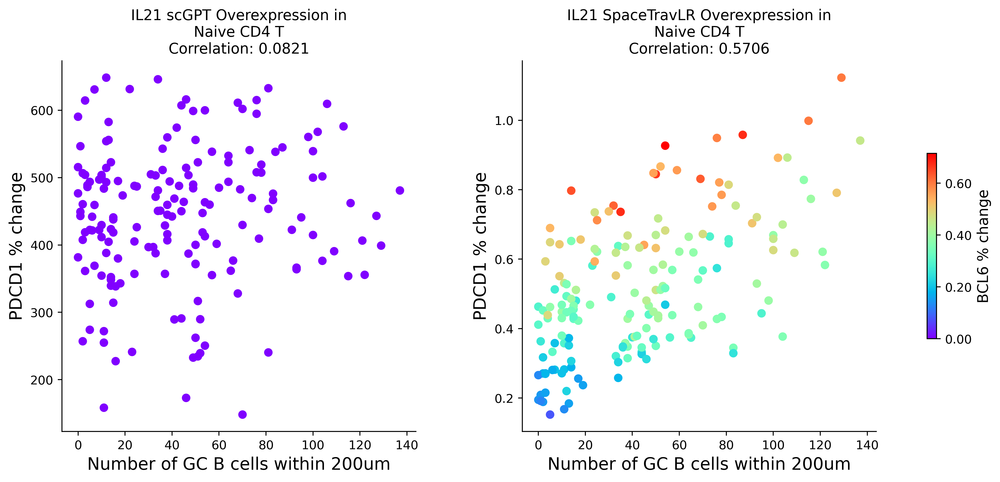

In [196]:
plt.rcParams['figure.figsize'] = (7, 6)
plt.rcParams['figure.dpi'] = 100

f, axs = plt.subplots(1, 2, figsize=(15, 5.5), dpi=200)
plt.subplots_adjust(wspace=0.3)

perturbed_df = pd.read_parquet(
    '/Volumes/SSD/genome_screens/human_tonsil_scGPT/IL21_4n_maxx.parquet')


ax1, df1 = plot_gene_vs_proximity(
    perturb_target='IL21',
    perturbed_df=perturbed_df, 
    mode='scGPT Overexpression',
    gene='PDCD1', 
    color_gene='BCL6', 
    cell_filter='Naive CD4 T', 
    ax=axs[0]
    
)

perturbed_df = pd.read_parquet(
    '/Volumes/SSD/genome_screens/human_tonsil/IL21_4n_maxx.parquet')


ax2, df2 = plot_gene_vs_proximity(
    perturb_target='IL21',
    perturbed_df=perturbed_df, 
    mode='SpaceTravLR Overexpression',
    gene='PDCD1', 
    color_gene='BCL6', 
    cell_filter='Naive CD4 T',
    ax=axs[1]
)
color_gene = 'BCL6'
vmin = min(df1[color_gene].min(), df2[color_gene].min())
vmax = max(df1[color_gene].max(), df2[color_gene].max())

for ax in axs:
    if ax.collections:
        for collection in ax.collections:
            if hasattr(collection, 'colorbar'):
                collection.colorbar.remove()

scatter = axs[1].scatter([], [], c=[], cmap='rainbow', vmin=vmin, vmax=vmax)
cbar = plt.colorbar(scatter, ax=axs, label=f'BCL6 % change', shrink=0.5, format='%.2f')
cbar.ax.tick_params(labelsize=10)
cbar.set_label(f'BCL6 % change', fontsize=12)

for ax in axs:
    ax.collections[0].set_clim(vmin, vmax)
plt.savefig(
    './figures/proximity_a.svg', 
    **figure_params
)
plt.show()

In [75]:
from shapely.geometry import Point, MultiPolygon

In [76]:
impact_df = pd.read_csv('../../notebooks/human_tonsil/impact_df.csv', index_col=0)
out_ko_data_scgpt = pd.read_csv('../../notebooks/human_tonsil/out_ko_data_scgpt.csv', index_col=0)
out_ko_data_co = pd.read_csv('../../notebooks/human_tonsil/out_ko_data_CO.csv', index_col=0)

In [73]:
genes2 = ['FOXP3', 'GATA3', 'IL7', 'LGALS9', 'CD27', 'CXCR4']

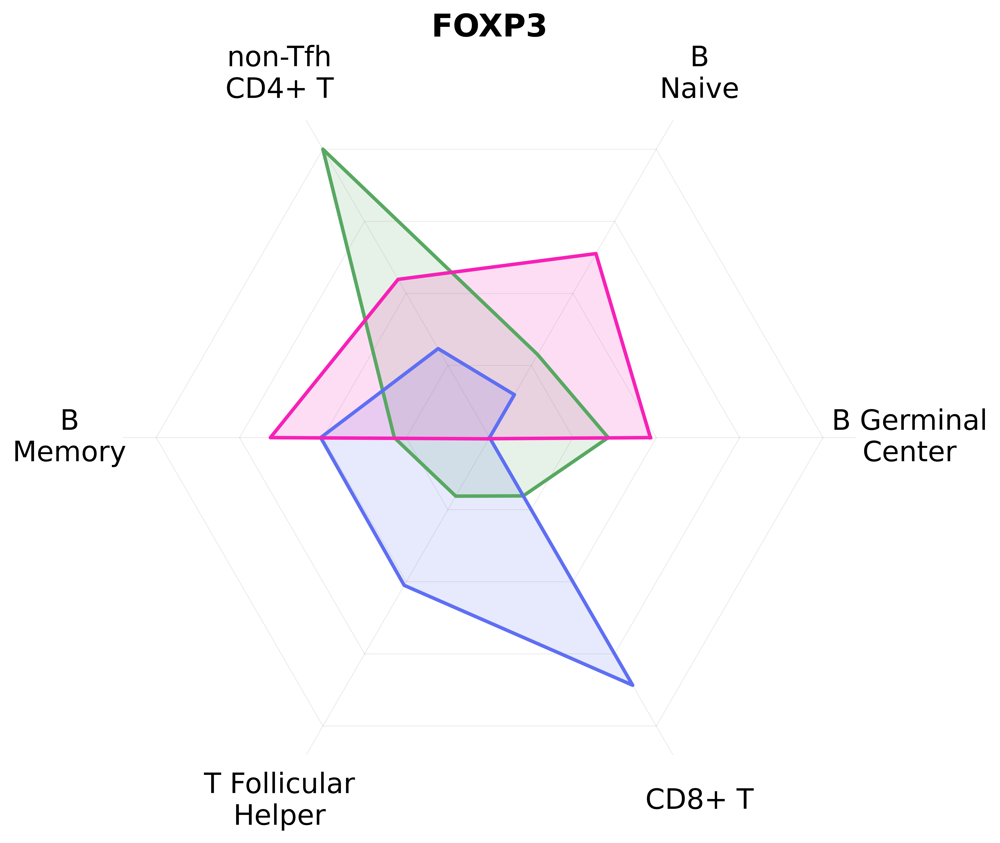

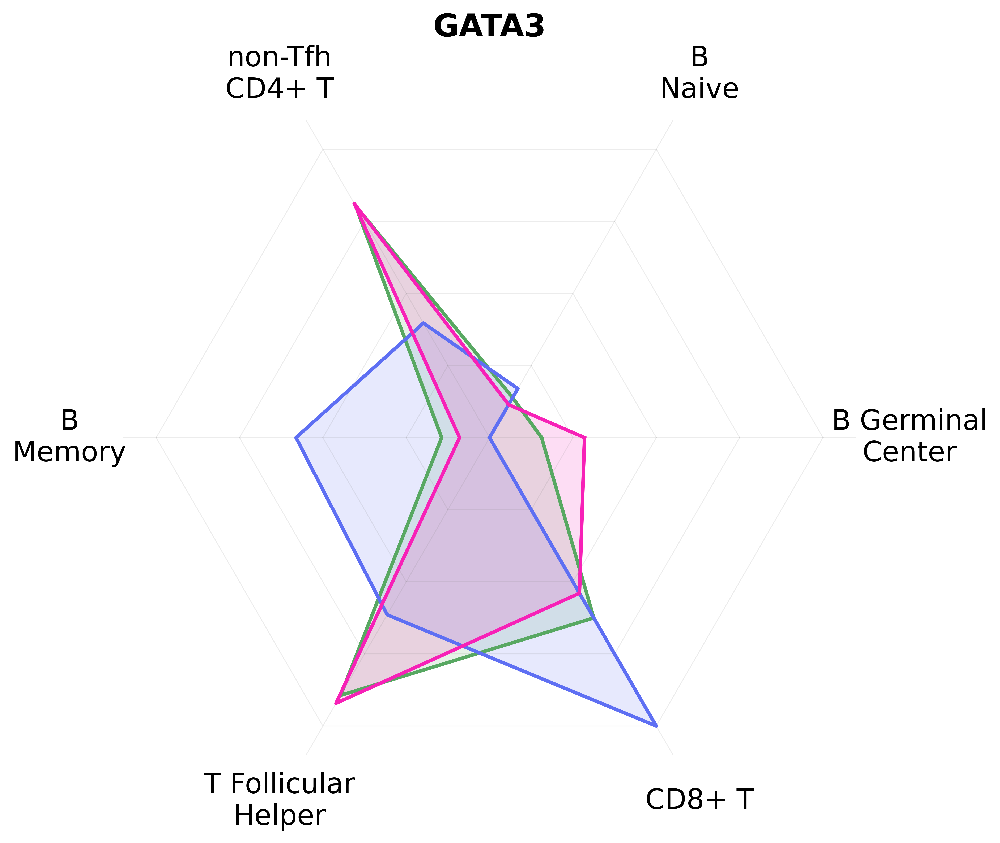

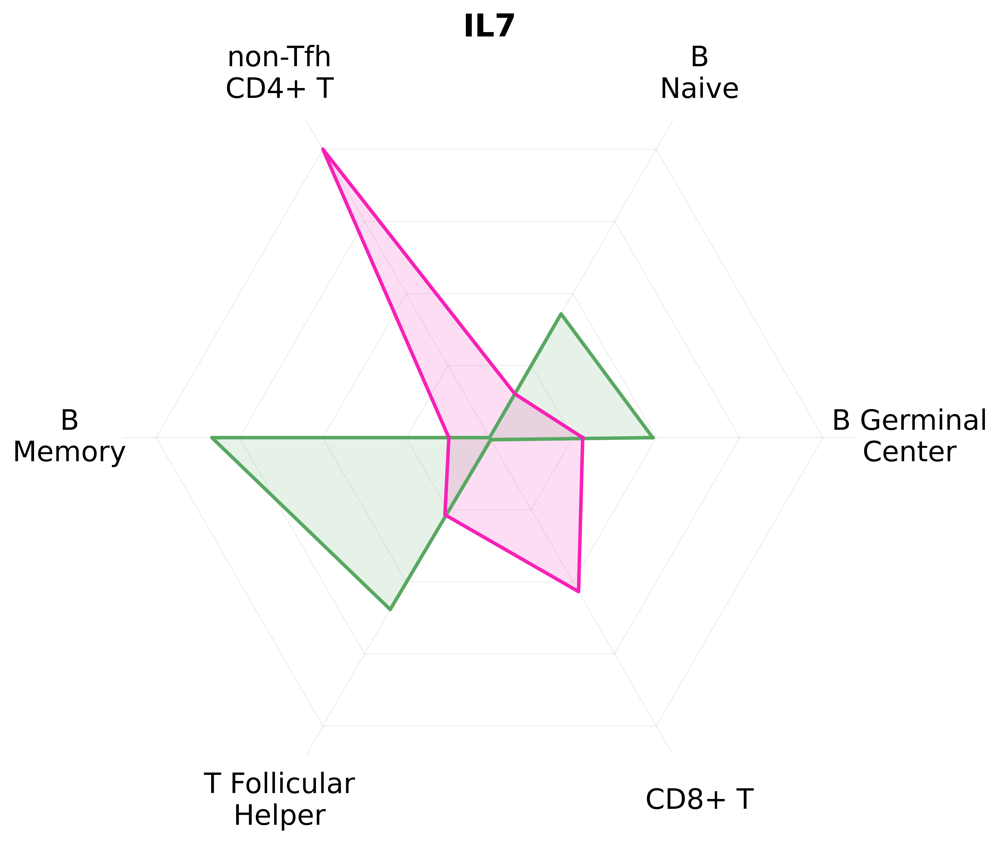

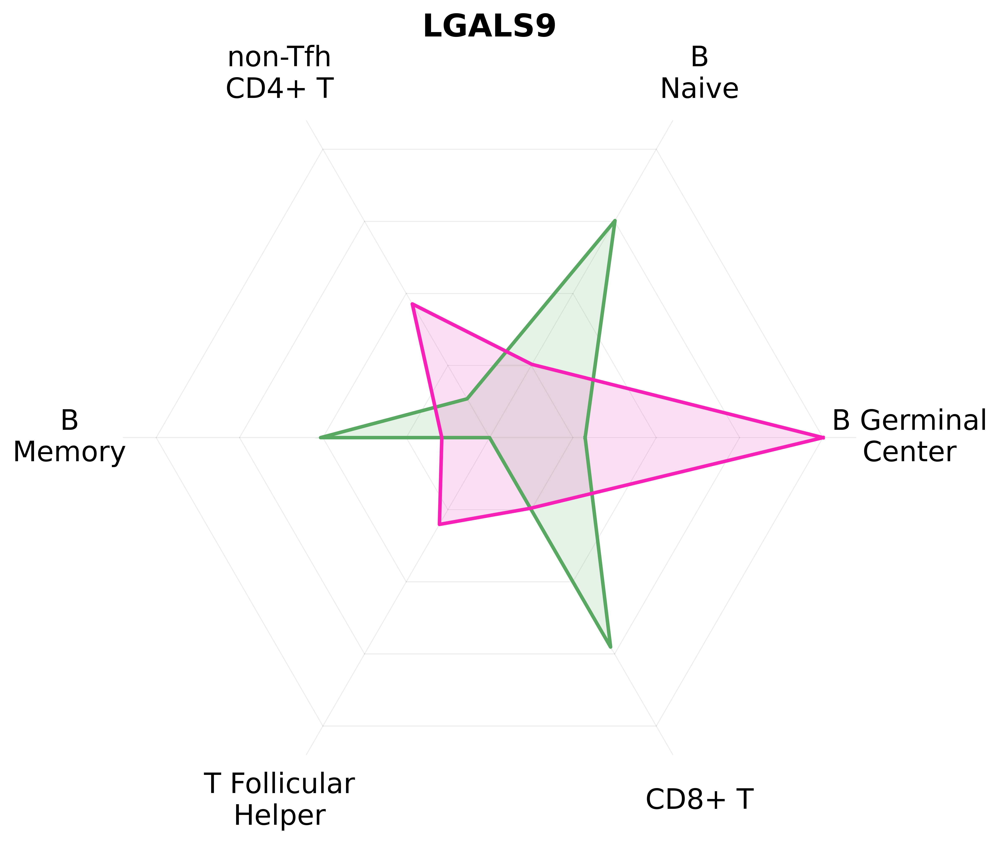

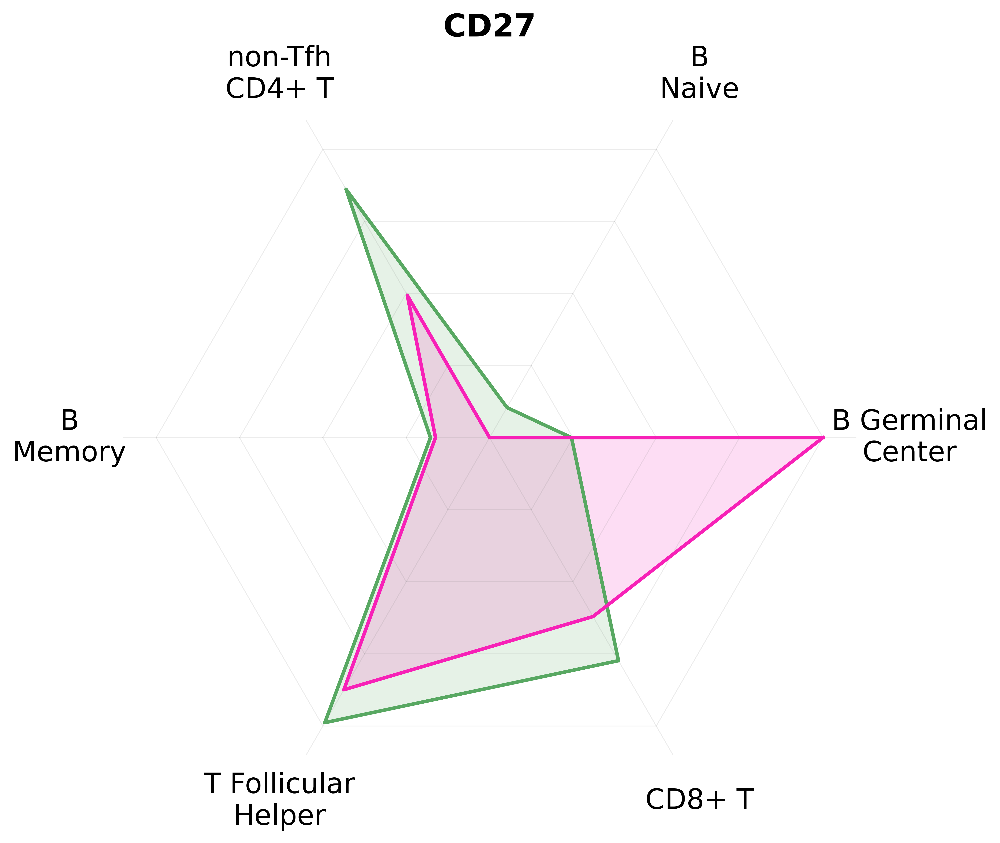

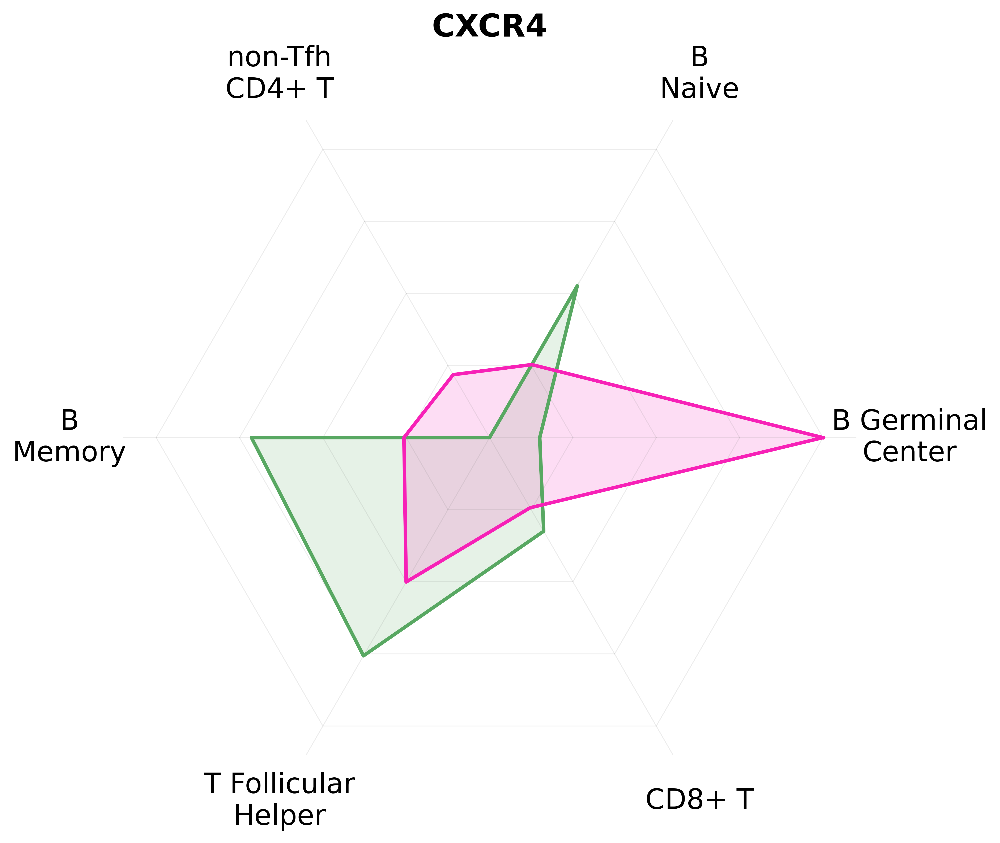

In [85]:
for i, gene in enumerate(genes2):
    fig = tonsil.plot_comparative_radar(
        gene=gene,
        impact_dfs=[out_ko_data_scgpt, out_ko_data_co, impact_df],
        labels=["scGPT", "CellOracle", "SpaceTravLR"],
        show_for=show_for,
        figsize=(8, 8),
        label_size=16,
        legend_size=14,
        rename=rename,
        dpi=300,
        color_dict=color_dict,
        show_legend=False
    )
    plt.savefig(f'./figures/comparative_radar_{gene}.svg', **figure_params)


In [681]:
chart.adata.obs['banksy_celltypes']

NAME
AAACCCACAGAAGTGC-1           GC Light Zone
AAACCCATCCGATCGG-1    GC Intermediate Zone
AAACGAATCCGTCCTA-1            GC Dark Zone
AAACGAATCTTTGGAG-1            GC Dark Zone
AAACGCTCAGCTGAAG-1           GC Light Zone
                              ...         
TTTGGAGGTTAACCTG-1           GC Light Zone
TTTGGAGTCTTCGGTC-1           GC Light Zone
TTTGGTTCATGTGACT-1            GC Dark Zone
TTTGTTGCAGGGACTA-1            GC Dark Zone
TTTGTTGGTACCACGC-1            GC Dark Zone
Name: banksy_celltypes, Length: 1743, dtype: category
Categories (3, object): ['GC Dark Zone', 'GC Intermediate Zone', 'GC Light Zone']

In [675]:
adata_ = adata[adata.obs['banksy_celltypes'].isin(
    ['GC Intermediate Zone','GC Dark Zone','GC Light Zone']
)]
adata_.obs['x'] = np.array(adata_.obsm['spatial'][:, 0]).copy()
adata_.obs['y'] = np.array(adata_.obsm['spatial'][:, 1]).copy()
chart = Cartography(adata_, color_dict)

In [704]:
ct_points_wt = {}
for ct in chart.adata.obs['cell_type_major'].unique():
    points = np.asarray(
        chart.adata.obsm['spatial'][chart.adata.obs['cell_type_major'] == ct])
    delta = 30
    points = np.vstack(
        (points +[-delta,delta], points +[-delta,-delta], 
        points +[delta,delta], points +[delta,-delta]))
    ct_points_wt[ct] = points
    
    
ct_points_split = {}
for ct in chart.adata.obs['cell_type_2'].unique():
    points = np.asarray(
        chart.adata.obsm['spatial'][chart.adata.obs['cell_type_2'] == ct])
    delta = 30
    points = np.vstack(
        (points +[-delta,delta], points +[-delta,-delta], 
        points +[delta,delta], points +[delta,-delta]))
    ct_points_split[ct] = points

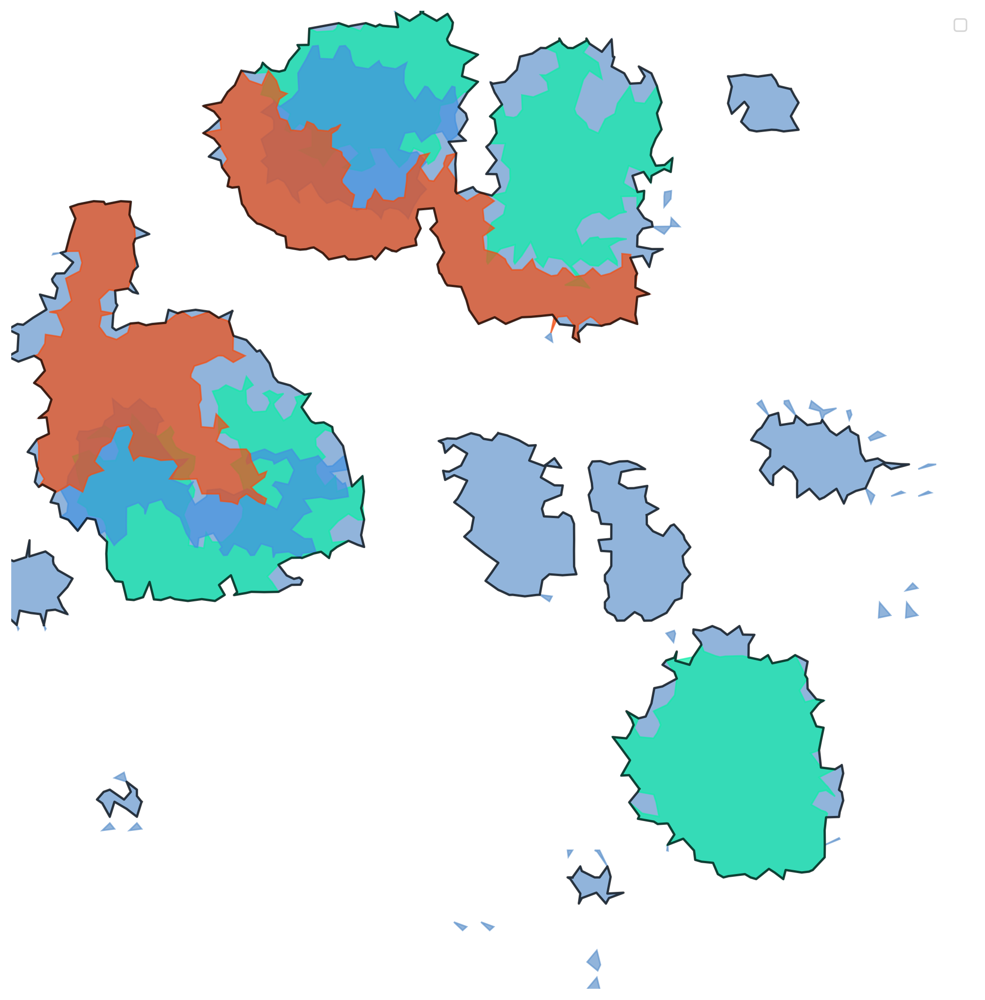

In [714]:
alpha_shapes = {}
alpha_shapes_split = {}


for cluster, points in ct_points_wt.items():
    alpha_shapes[cluster] = alphashape.alphashape(points, alpha=0.05)
    
for cluster, points in ct_points_split.items():
    alpha_shapes_split[cluster] = alphashape.alphashape(points, alpha=0.05)

fig, ax = plt.subplots(figsize=(20, 9), dpi=120)

zone_alpha = 0.7
area_thresh = 0

for cluster in ['Germinal Center B cells']:
    alpha_shape = alpha_shapes.get(cluster)
    
    if alpha_shape is None:
        continue

    if isinstance(alpha_shape, MultiPolygon):
        for geom in alpha_shape.geoms:
            if geom.area > area_thresh:
                ax.fill(
                    geom.exterior.xy[0], 
                    geom.exterior.xy[1], 
                    color=color_dict[str(cluster)], alpha=zone_alpha)
    else:
        geom = alpha_shape
        ax.fill(
            geom.exterior.xy[0], 
            geom.exterior.xy[1], 
            color=color_dict[str(cluster)], 
            alpha=zone_alpha
        )
        
    for geom in alpha_shape.geoms:
        if geom.area > 1000:
            ax.plot(
                geom.exterior.xy[0], 
                geom.exterior.xy[1], 
                color='black', alpha=zone_alpha)


for cluster in ['GC Light Zone', 'GC Intermediate Zone', 'GC Dark Zone']:
    alpha_shape = alpha_shapes_split.get(cluster)
    
    if alpha_shape is None:
        continue

    if isinstance(alpha_shape, MultiPolygon):
        for geom in alpha_shape.geoms:
            if geom.area > 50000:
                ax.fill(
                    geom.exterior.xy[0], 
                    geom.exterior.xy[1], 
                    color=color_dict[str(cluster)], alpha=zone_alpha)
    else:
        geom = alpha_shape
        ax.fill(
            geom.exterior.xy[0], 
            geom.exterior.xy[1], 
            color=color_dict[str(cluster)], 
            alpha=zone_alpha
        )
        
# for ct in chart.adata.obs['banksy_celltypes'].unique():
#     ax.scatter(
#         chart.adata[chart.adata.obs['banksy_celltypes'] == ct].obsm['spatial'][:, 0],
#         chart.adata[chart.adata.obs['banksy_celltypes'] == ct].obsm['spatial'][:, 1],
#         c=color_dict[ct], alpha=1, edgecolor='black', linewidth=1,
#         label=ct
#     )



handles, labels = ax.get_legend_handles_labels()
ax.legend(handles, labels)

ax.set_frame_on(False)
ax.set_xticks([])
ax.set_yticks([])
ax.set_xlabel('')
ax.set_ylabel('')
ax.set_aspect('equal')
ax.set_xlim(adata_.obs.x.min() - 10, adata_.obs.x.max() + 10)
ax.set_ylim(adata_.obs.y.min() - 10, adata_.obs.y.max() + 10)
plt.tight_layout()
plt.savefig(
    '/tmp/GC_Zones.svg', 
    **figure_params
)

plt.show()